## Processing Ocean Color Imagery

This is flight 20210827_A1 from gulf_stream_surveys.

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import geopandas as gpd
import pandas as pd


import os, glob
import multiprocessing
import math

#import cv2
import numpy as np
import matplotlib.pyplot as plt

#import exiftool
import datetime
from datetime import timedelta


import rasterio

from utils import *
from georeg import *

Define the data directory

In [3]:
data_dir = os.path.join('data', '210828_A2_dyefrontcross2')
data_dir

'data/210828_A2_dyefrontcross2'

In [4]:
! ls data/210828_A2_dyefrontcross2

0000SET  RedEdge  SYNLog-19-26-19_28-08-2021.csv
panel	 sea	  SYNLog-19-26-19_28-08-2021_edited.csv


Grab last 4 characters of the file names, which are the img numbers and sort them

In [5]:
def last_10chars(x):
    return(x[-10:])

img_fns = glob.glob(data_dir + '/sea' + "/*.tif")

img_fns = sorted(img_fns, key = last_10chars)
len(img_fns)

1734

Open up the logs from the aircraft which are much more accurate than the GPS and compas from the Altum

In [6]:
data_dir

'data/210828_A2_dyefrontcross2'

In [7]:
alta_logs = format_alta_logs(data_dir + '/SYNLog-19-26-19_28-08-2021_edited.csv')
alta_logs.head()

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3347: DtypeWarning: Columns (0,1,2,4,5,6,7,9) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


,Reading,IMU Time,Date,GPS Time,Unnamed: 4,Longitude,Latitude,GPS Height,GPS Course,GPS Pos N,...,Gyro Bias P,Gyro Bias Y,Accel Bias X,Accel Bias Y,Accel Bias Z,Extended Status,5V Alarm,Z Vibration,Checksum,id
dt,,,,,,,,,,,,,,,,,,,,,
2021-08-28 19:26:20.000000,23,0.88,20210828,19:26:20,NaN,-746302848,357878720,4.95,4.3,83.72,...,-41.6742,8.1066,0.024,0.022,0.285,0.0,0.0,0.05,155.0,0
2021-08-28 19:26:20.000001,24,0.92,20210828,19:26:20,NaN,-746302848,357878720,4.95,4.3,83.72,...,-41.6704,8.1070,0.028,0.026,0.285,0.0,0.0,0.05,89.0,1
2021-08-28 19:26:20.000002,25,0.96,20210828,19:26:20,NaN,-746302848,357878720,4.95,4.3,83.72,...,-41.6685,8.1057,0.032,0.030,0.285,0.0,0.0,0.06,125.0,2
2021-08-28 19:26:20.000003,26,1,20210828,19:26:20,NaN,-746302848,357878720,4.95,4.3,83.72,...,-41.6710,8.1018,0.037,0.035,0.285,0.0,0.0,0.06,168.0,3
2021-08-28 19:26:20.000004,27,1.04,20210828,19:26:20,NaN,-746302848,357878720,4.95,4.3,83.72,...,-41.6756,8.1013,0.041,0.039,0.284,0.0,0.0,0.06,103.0,4


Path to the processed sea images

In [8]:
surface_dir = os.path.join(data_dir, 'sea', 'stacks')

### grab all the image metadata and visualize flight

In [9]:
mds = load_img_fn_and_meta(surface_dir, start=0)
len(mds)

288

In [10]:
len(alta_logs)

15152

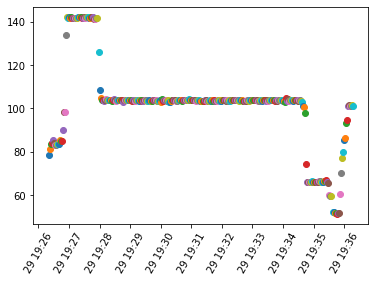

In [11]:
for i in np.arange(0,15000,50):
    plt.scatter(pd.to_datetime(alta_logs.iloc[i]['GPS Time']),alta_logs.iloc[i]['Yaw'])
    #plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['yaw'])
plt.xticks(rotation=60)
plt.show()

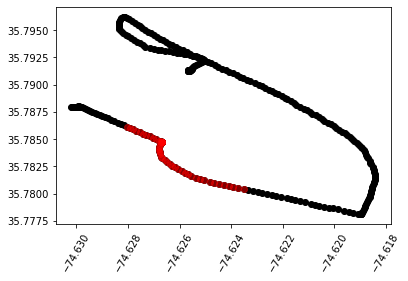

In [12]:
for md in mds:
    plt.scatter(md['Longitude'],md['Latitude'], color='black')
for md in mds[30:80]:
    plt.scatter(md['Longitude'],md['Latitude'], color='red', alpha=0.5)
plt.xticks(rotation=60)
plt.show()

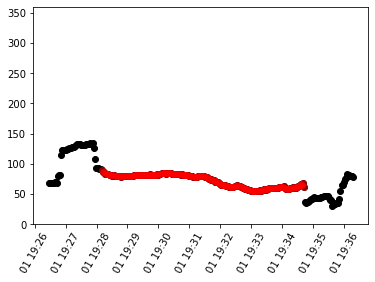

In [13]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['yaw'], color='black')

for md in mds[50:-46]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['yaw'], color='red', alpha=0.5)
plt.ylim(0,360)
plt.xticks(rotation=60)
plt.show()

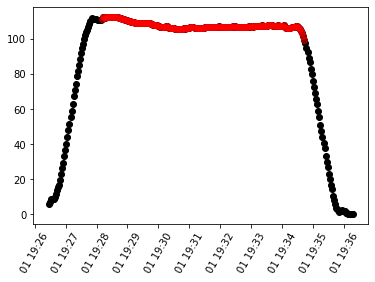

In [14]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'], color='black')

for md in mds[50:-46]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'], color='red', alpha=0.5)
plt.xticks(rotation=60)
plt.show()

#### Open up a subset of the images to visualize based on the above metadata

All images can't be opened at the same time given the load on computer memory

In [18]:
start = 50 # where to start in the image order
count = 40 # how many images to open
sea_imgs, sea_img_metadata = retrieve_imgs_and_metadata(surface_dir, count=count, start=start, altitude_cutoff=0)

In [ ]:
sea_imgs.shape

Find the closest row in the flight logs based on time stamp and add the more accurate yaw to the metadata

In [19]:
for item in sea_img_metadata:
    utc_time = datetime.datetime.strptime('2021-08-28-' + item['UTC-Time'], '%Y-%m-%d-%H:%M:%S')
    img_idx = alta_logs.index.get_loc(utc_time, method='nearest')
    item['log_id'] = img_idx
    item['alta_yaw'] = (alta_logs.iloc[img_idx]['Yaw'] + 360) % 360
    # then ensures
    item['image_name'] = img_fns[start*6+item['id']*6]

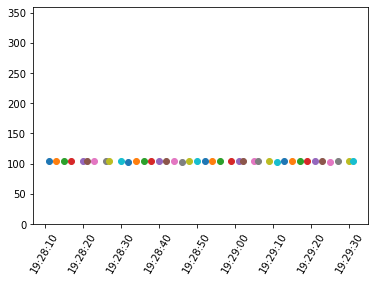

In [20]:
for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_yaw'])
    plt.xticks(rotation=60)
    plt.ylim(0,360)

In [21]:
sea_imgs.nbytes / 1e9

5.70301056

Open up the data from the sunblocked approach measurements

In [22]:
blocked_dir = os.path.join('data/210828_A2_dyefrontcross2', 'RedEdge', 'tube', 'stacks')
blocked_dir

'data/210828_A2_dyefrontcross2/RedEdge/tube/stacks'

In [23]:
blocked_imgs, blocked_img_metadata = retrieve_imgs_and_metadata(blocked_dir, count=20, start=0, altitude_cutoff=0)

In [24]:
len(blocked_imgs)

12

Inspect a couple images, first with just blue and green

In [25]:
band_names = ['blue', 'green', 'red', 'nir', 'red edge']

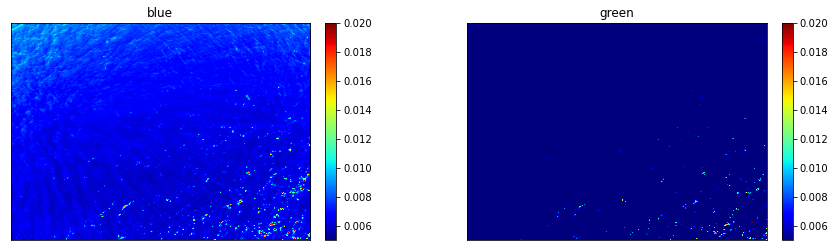

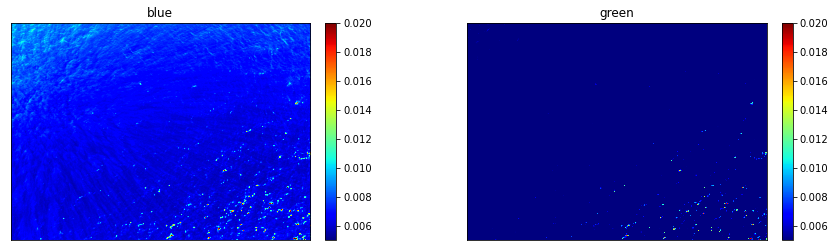

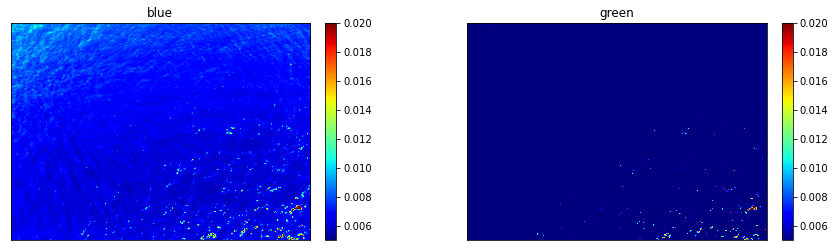

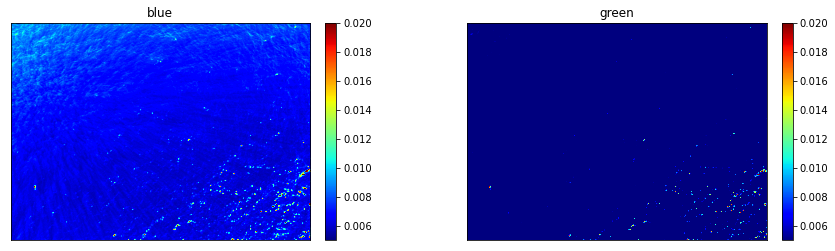

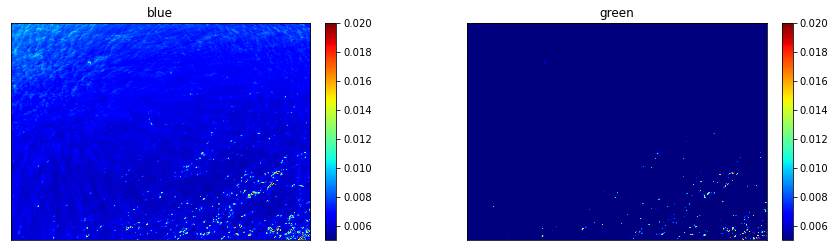

...

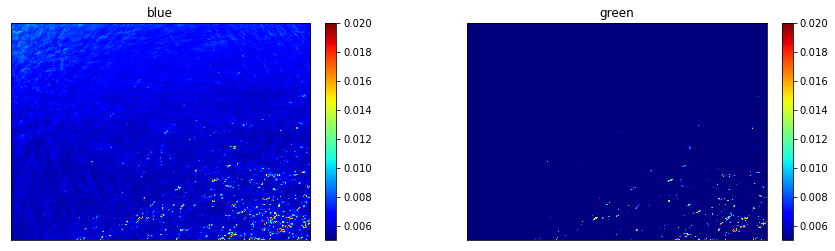

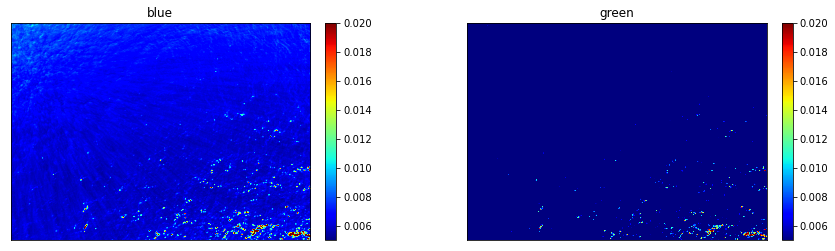

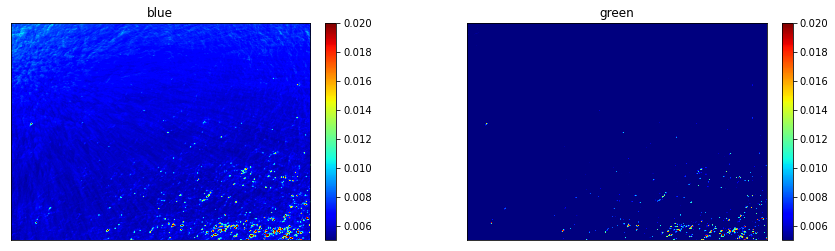

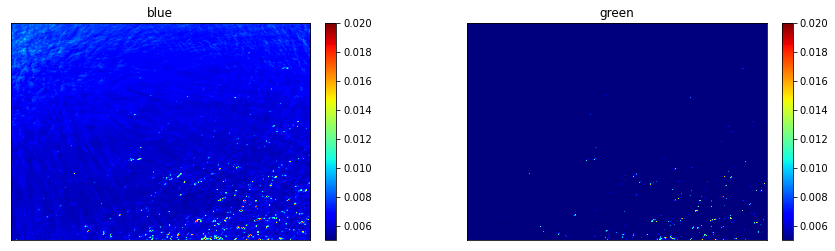

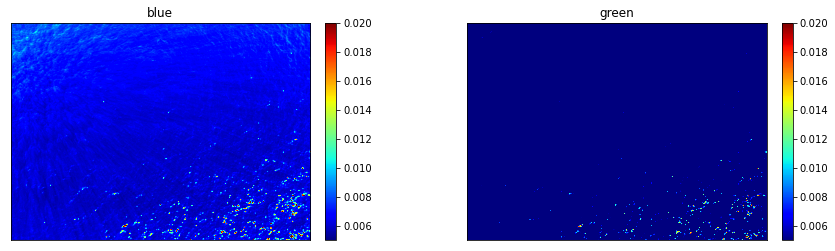

In [25]:
for i in range(15):
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.005, vmax=.02)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sea_imgs[i,1],cmap='jet', vmin=0.005, vmax=.02)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

Now look at all bands

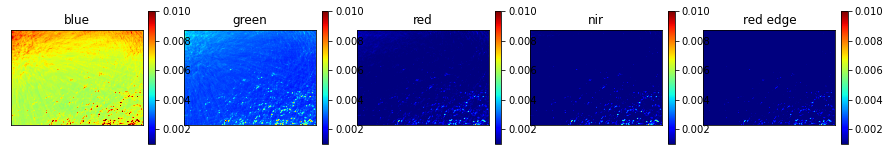

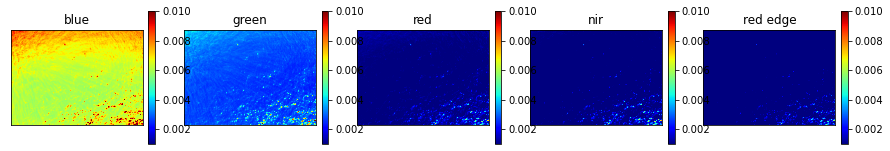

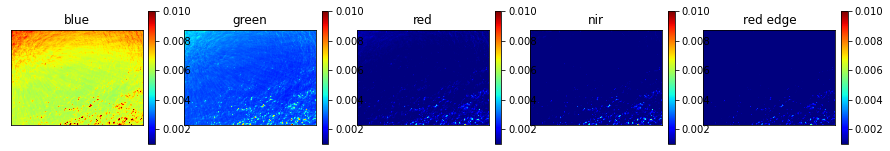

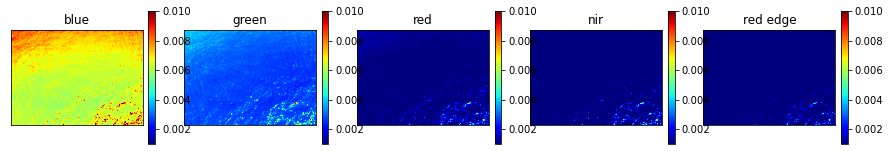

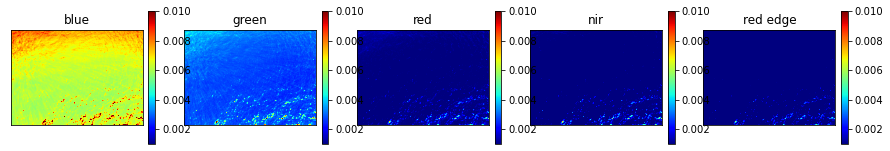

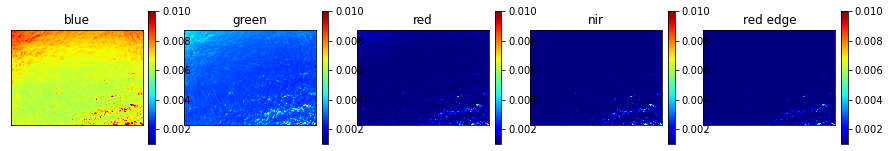

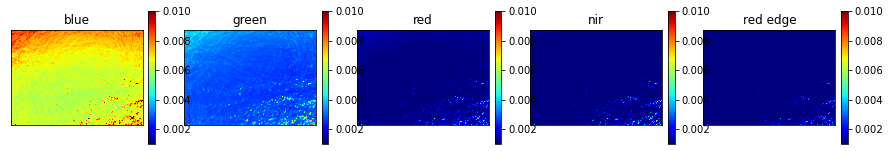

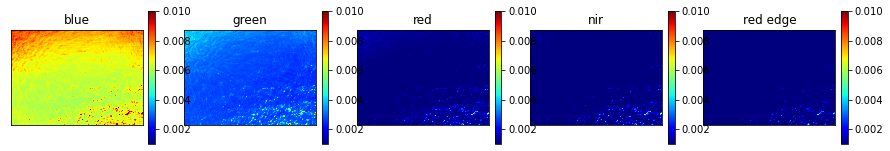

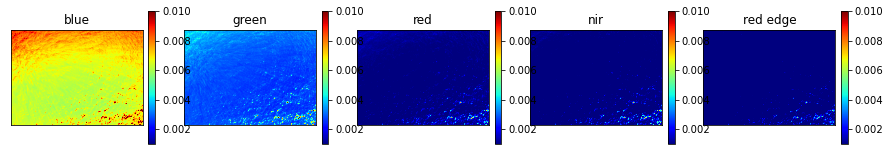

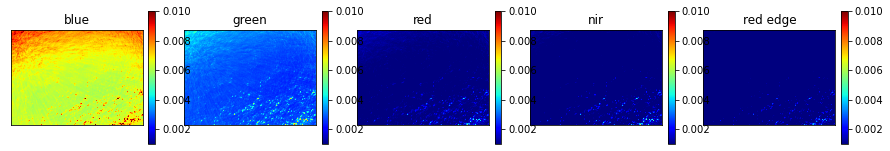

In [40]:
for j in range(20,30):
    fig, ax = plt.subplots(1,5, figsize=(15,4))
    for i in range(5):
        im = ax[i].imshow(sea_imgs[j,i],cmap='jet', vmin=0.001, vmax=.01)
        fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(band_names[i])

Visualize some stacked RGB images, the 0.01 value is just empirical to get a good idea of how the image looks when properly stretched

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


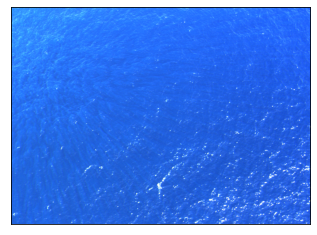

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


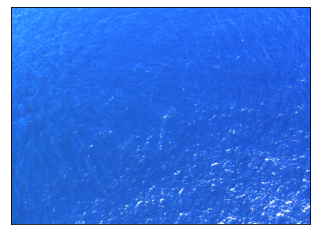

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


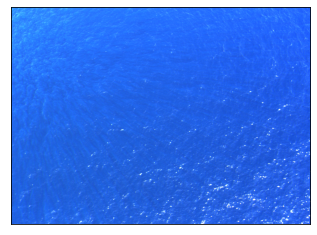

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


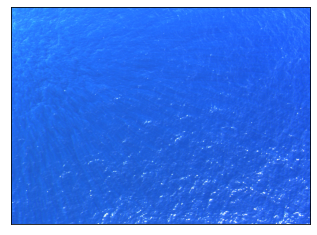

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


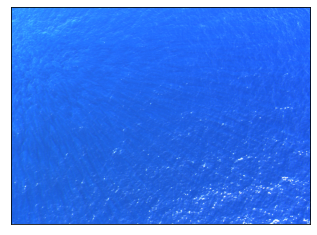

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


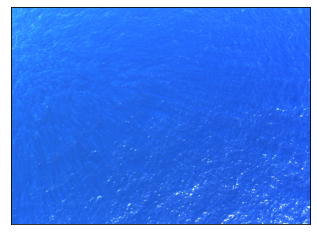

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


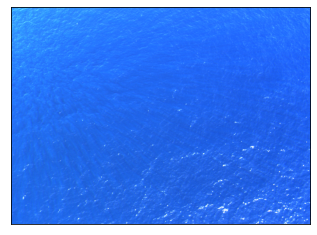

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


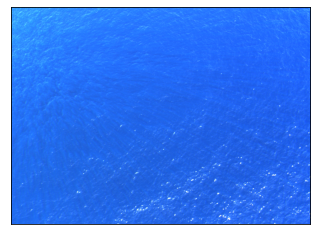

In [43]:
for j in [5,10,15,20, 25,30,35, 39,]:
    plt.imshow((np.transpose(sea_imgs[j,0:3]/0.007, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

Save out every file as a png just for visualization

In [ ]:
for i in range(50,len(mds)-50):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    fig,ax = plt.subplots(1,2,figsize=(16,6))
    ax[0].imshow((np.transpose(img[0,0:3]/0.01, (1,2,0))[:,:,::-1]))
    ax[1].imshow(img[0,5]*math.pi*32768/100-273.15,cmap='inferno', vmax=30,vmin=25)
    fig.savefig('data/210827_A1_frontcross1/anims/img_sst_'+str(i).zfill(4)+'.png')   # save the figure to file
    plt.close()  


## Start correction to obtain accurate Ls*rho from Lw from Lt measurements 

### create medians of each image for correction

In [44]:
sea_imgs.shape

(40, 6, 1469, 2022)

Which images are used to median the data has a major impact on the outcome and must be images without major outlier features or patterns

In [26]:
sea_median = np.median(sea_imgs[20:40], axis=0)

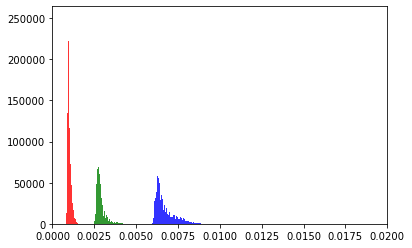

In [46]:
plt.hist(sea_median[0].flatten(), bins=300, color='blue', alpha=0.8)
plt.hist(sea_median[1].flatten(), bins=300, color='green', alpha=0.8)
plt.hist(sea_median[2].flatten(), bins=300, color='red', alpha=0.8)
plt.xlim(0.000,0.02)
plt.show()

In [47]:
np.median(sea_median, axis=(1,2))

array([0.00650355, 0.00281222, 0.00096655, 0.00078684, 0.0006217 ,
       0.29213539])

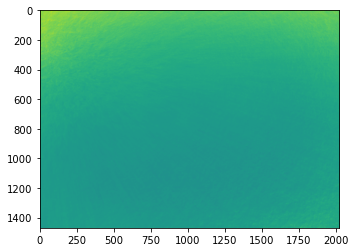

In [48]:
plt.imshow(sea_median[0], vmin=0.002,vmax=.01, cmap='viridis')

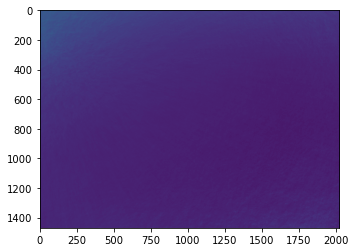

In [49]:
plt.imshow(sea_median[1], vmin=0.002,vmax=.01, cmap='viridis')

#### inspect the sun blocked spectra based on the brightest pixels there

The assumption is that the brightest pixels will be the ones that are measureing Lw rather than the tube since the imagers FOV is so large

In [27]:
blocked_imgs.shape

(12, 5, 947, 1272)

brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204


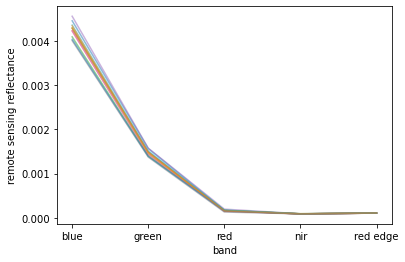

In [28]:
blocked_spectra = []
for i in range(0,blocked_imgs.shape[0]):
    spec = brightest_tube_pix(blocked_imgs[i], percent=0.001)
    plt.plot(band_names, spec, alpha=0.5)
    plt.ylabel('remote sensing reflectance')
    plt.xlabel('band')
    blocked_spectra.append(spec)
blocked_spectra = np.array(blocked_spectra)

We then take the median of these brightest spectra to get the value used. This relies on a dozen or so measurements to ensure that outliers like from foam don't bias the measurements.

In [29]:
median_blocked_spec = np.median(blocked_spectra,axis=0)
median_blocked_spec

array([4.28866696e-03, 1.47264224e-03, 1.61447620e-04, 8.70230141e-05,
       1.04587366e-04])

Define the ocean color index from Hu et al 2012

In [30]:
ci1 = -0.49
ci2 = 191.6590

# ci1 = -0.38152295986028695
# ci2 = 271.37634868

# average of 443*.5 + 489*1.5
# ci1 = -0.30002281538304754
# ci2 = 310.5772338

# ci1 = -0.21380600002416383
# ci2 = 572.01573044



def oc_index(blue, green, red):
    #blue, green, red = blue/math.pi, green/math.pi, red/math.pi
    CI = green - ( blue + (555 - 477)/(667 - 477) * (red - blue) )
    
    #print(green)
    #print(( blue + (555 - 443)/(667 - 443) * (red - blue) ))
    
    #print(CI)

    ChlCI = 10**(ci1 + ci2*CI)
    return(ChlCI)

This is the L8 OC2 algorithm from NASA

In [54]:
vec_chla_img(median_blocked_spec[0],median_blocked_spec[1])

1.011748038651109

In [55]:
print('chla is: ', oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]))

chla is:  0.27641967525777467


In [56]:
def combined_oc(ChlCI, oc2m):
    thresh = [0.15, 0.20]
    if ChlCI <= thresh[0]:
        chlor_a = ChlCI
    elif ChlCI > thresh[1]:
        chlor_a = oc2m
    else:
        chlor_a = oc2m * (ChlCI-thresh[0]) / (thresh[1]-thresh[0]) +\
            ChlCI * (thresh[1]-ChlCI) / (thresh[1]-thresh[0])
    return(chlor_a)


In [57]:
combined_oc(oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]),
            vec_chla_img(median_blocked_spec[0],median_blocked_spec[1]))

1.011748038651109

Run through each image, subtract the blocked spectra, then find the average spectra, then run chla algorithm on it, then add it to list

### Correct for sun glint

This is the current approach to calculating rho based on sunblocked spectra

Simple explaination is:

Take the blocked spectra and subtract that from Lt and then smooth that over and that is the correction to all the other images.

Sea median - blocked_spectra is equivalent to lsky * rho. So then to get Lw in the future from Lt measurements all you need to do is subtract lsky * rho from Lt.

Calculate the smoothed Lt - Lw

This needs to be heavily smoothed so that no random waves remain in the final rho*Lsky

In [31]:
smoothed_lt_lw = ndimage.gaussian_filter(((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0)).T), sigma=(0, 45,45), order=0)

Visualize the sea median bands that we calculated previously

In [ ]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i],cmap='jet', vmin=0.001, vmax=.015)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

In [ ]:
fig, ax = plt.subplots(figsize=(15,10))
im = ax.imshow(smoothed_lt_lw[0],cmap='magma', vmin=0.001, vmax=.006)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Sea median images divided by image mean

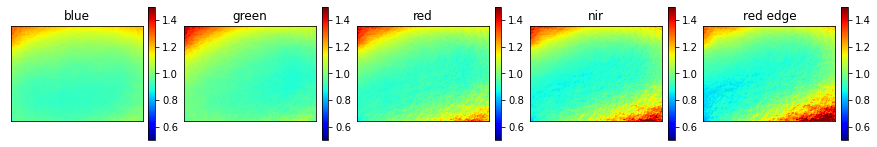

In [61]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i]/np.mean(sea_median[i]),cmap='jet', vmin=0.5, vmax=1.5)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Histogram of data from these bands

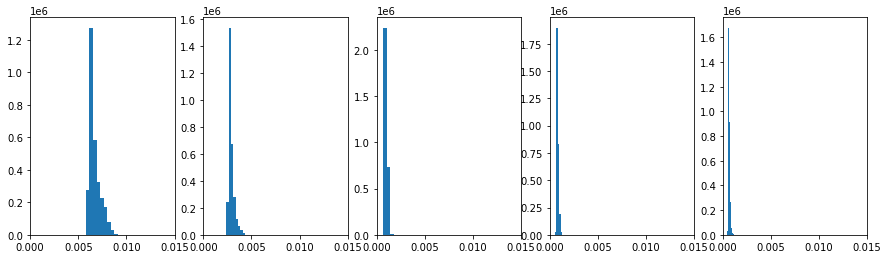

In [62]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    ax[i].hist(sea_median[i].flatten())
    ax[i].set_xlim(0,.015)

Smoothed lt - lw images (aka rho*lsky)

**This is what will be subtracted from each image**

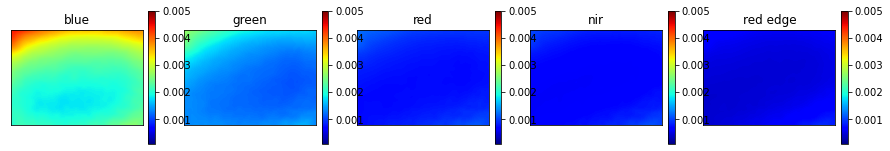

In [63]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i],cmap='jet', vmin=0.0001, vmax=.005)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt - lw divided buy the mean of that

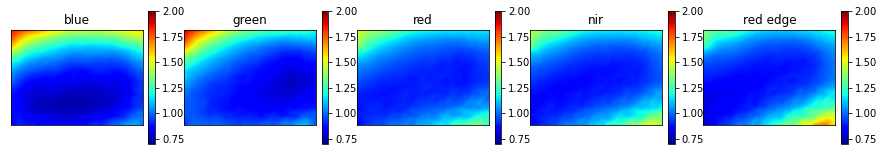

In [64]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/np.mean(smoothed_lt_lw[i]),cmap='jet', vmin=.7, vmax=2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

### Apply simple approach

just take smoothed_lt_lw and subtract it from the lt images

First look at all bands

In [32]:
sea_imgs.shape

(40, 6, 1469, 2022)

In [33]:
np.median(blocked_spectra, axis=0)

array([4.28866696e-03, 1.47264224e-03, 1.61447620e-04, 8.70230141e-05,
       1.04587366e-04])

In [34]:
np.median(sea_imgs[5], axis=(1,2))

array([0.0064307 , 0.00281707, 0.00101026, 0.00081598, 0.00064113,
       0.29338364])

In [68]:
np.median(smoothed_lt_lw, axis=(1,2))

array([0.00220569, 0.00134028, 0.00080256, 0.00069929, 0.0005137 ])

[0.00425013 0.00144777 0.00019208 0.00012174 0.00012584]


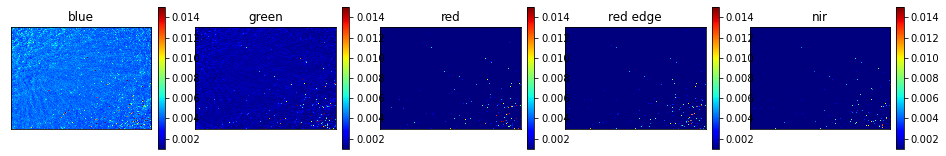

[0.00428878 0.00146415 0.00020185 0.0001319  0.00012949]


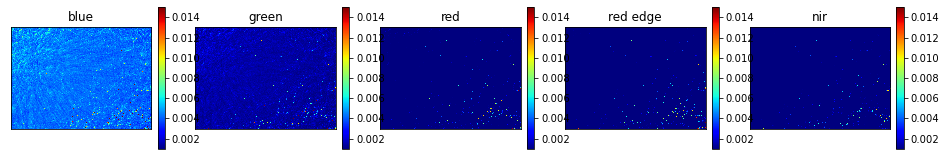

[0.00428022 0.00146142 0.0001974  0.00013082 0.00012586]


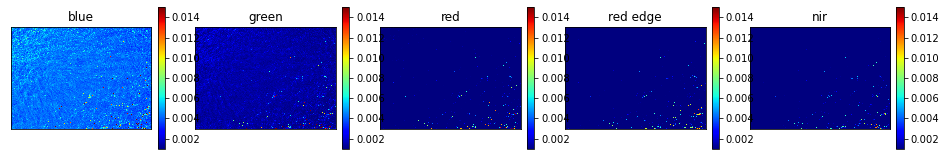

[0.00427536 0.00145627 0.00020165 0.00010957 0.00012719]


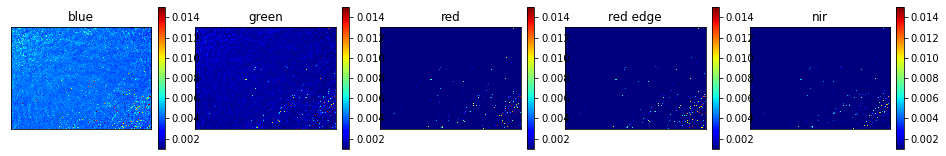

[4.13056668e-03 1.43987701e-03 1.86357879e-04 8.91873789e-05
 1.23756652e-04]


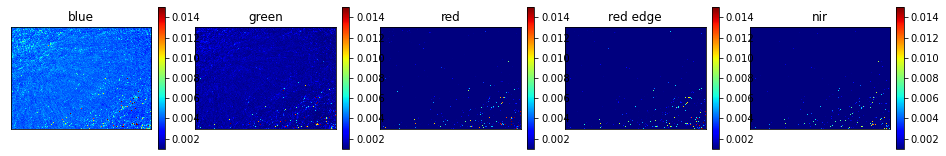

[0.00413169 0.0014436  0.0001892  0.00010297 0.00012298]


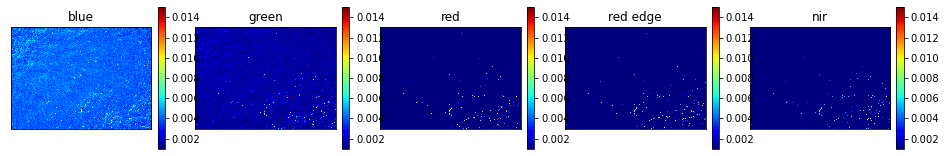

[0.00414522 0.00144659 0.00018085 0.00012158 0.00012492]


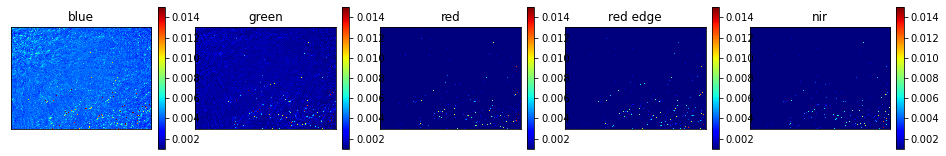

[4.04937628e-03 1.43321246e-03 1.83214668e-04 8.21754038e-05
 1.20038966e-04]


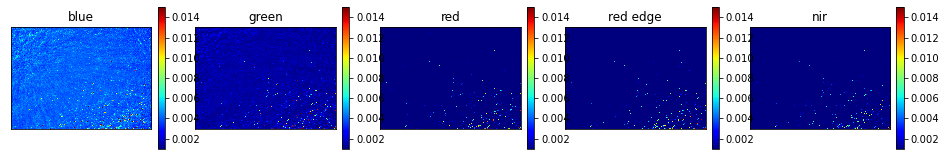

[4.03248784e-03 1.41562248e-03 1.74054086e-04 9.12853395e-05
 1.14809865e-04]


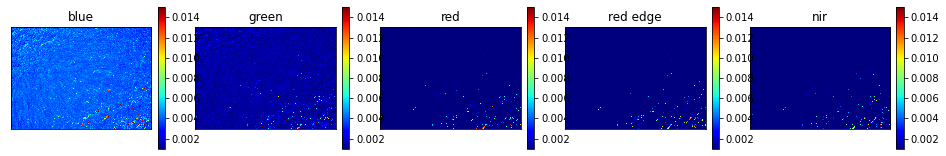

[4.12289093e-03 1.39987086e-03 1.69386978e-04 7.26632293e-05
 1.12688630e-04]


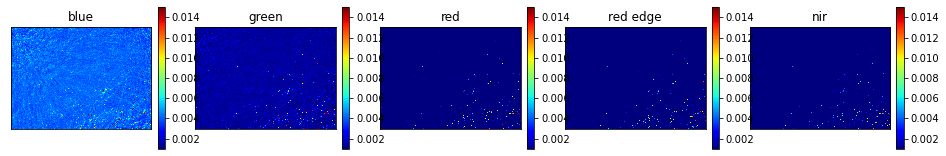

[0.00388845 0.00138711 0.0001708  0.00011072 0.00011488]


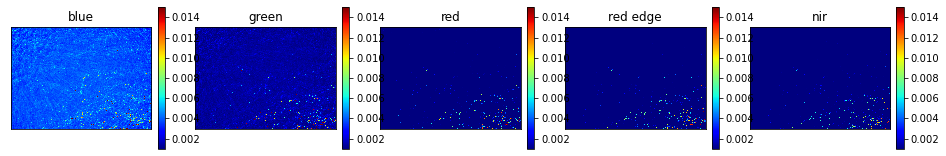

[3.97460892e-03 1.39360850e-03 1.70698395e-04 7.77973256e-05
 1.06191685e-04]


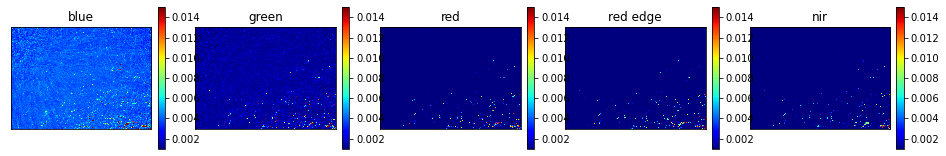

[0.0039736  0.00138157 0.00016892 0.00011156 0.00010806]


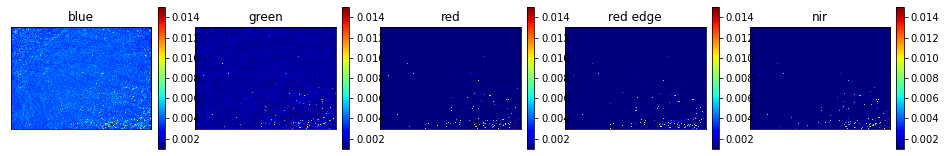

[3.99562523e-03 1.39953153e-03 1.68495921e-04 7.99471229e-05
 1.13865124e-04]


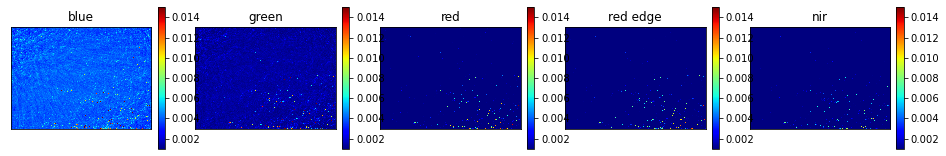

[3.98557975e-03 1.38439853e-03 1.67993184e-04 8.76882350e-05
 1.10669959e-04]


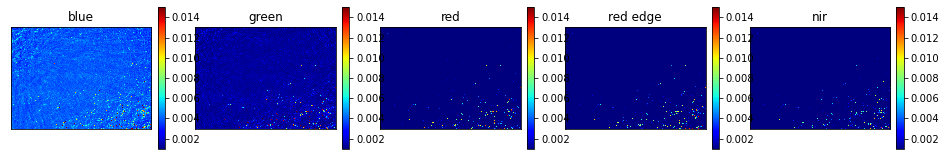

[4.14042854e-03 1.37130667e-03 1.54270941e-04 9.36749154e-05
 1.07730574e-04]


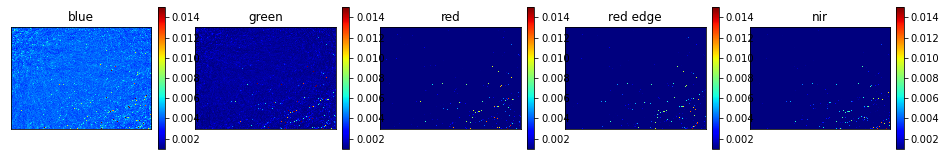

[0.0040983  0.00139872 0.00016767 0.00010538 0.00010904]


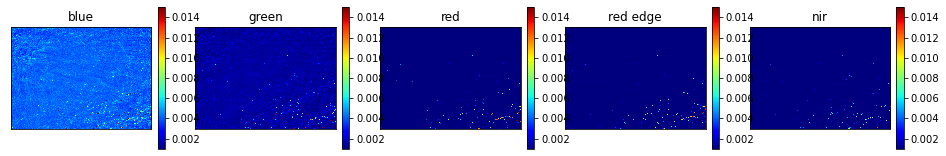

[4.10399985e-03 1.40324721e-03 1.67193653e-04 9.11083857e-05
 1.09206498e-04]


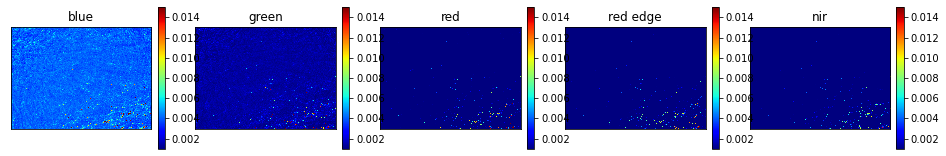

[4.18425633e-03 1.39131371e-03 1.59858715e-04 8.43292699e-05
 1.03474053e-04]


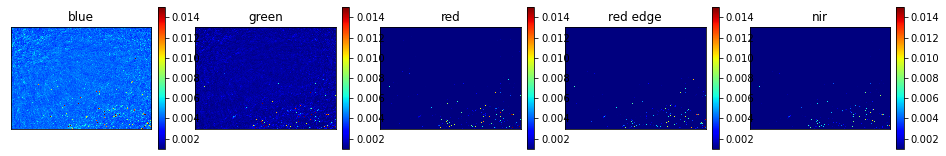

[4.10647172e-03 1.39937292e-03 1.63871019e-04 7.60639265e-05
 1.05685304e-04]


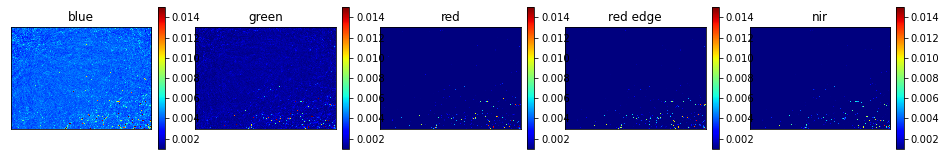

In [69]:
for i in range(0,20):
    print(np.median(sea_imgs[i,:5] - smoothed_lt_lw, axis=(1,2)))
    visualize_darkest_pixels(sea_imgs[i,:5] - smoothed_lt_lw, lowest_percent=1, max_clim=0.015, min_clim=0.001, only_img=True)

Now let's look at before and after with blue and green bands using the same scale and filtering out some of the brightest pixels.

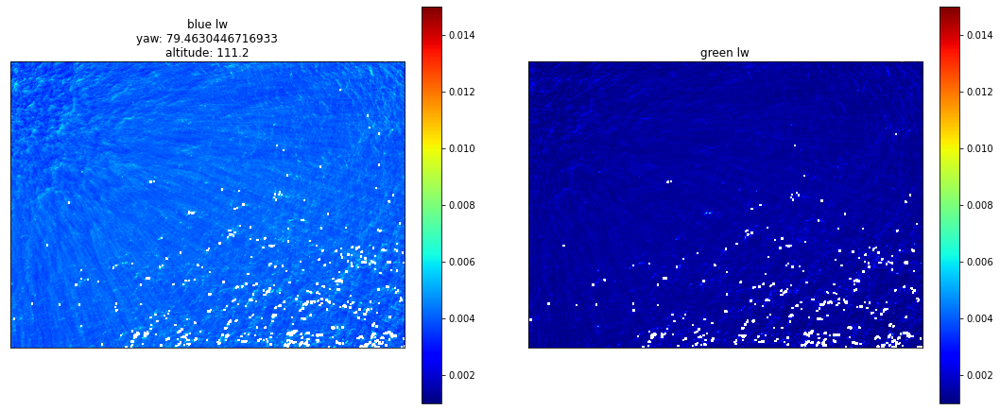

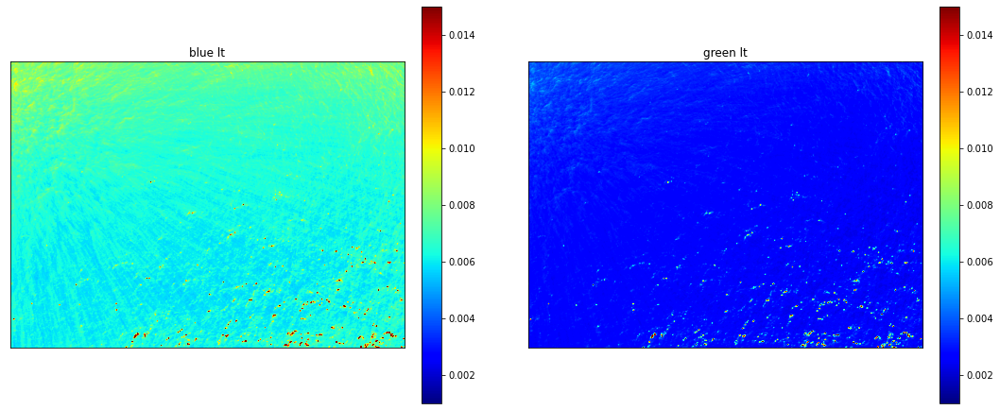

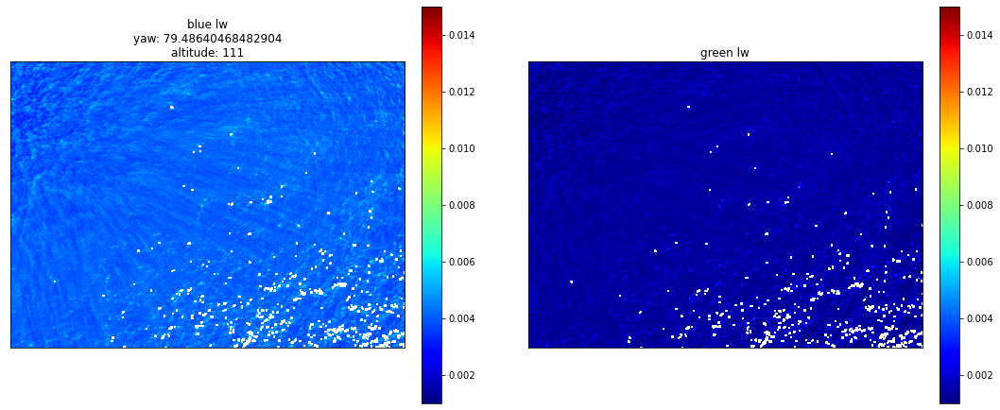

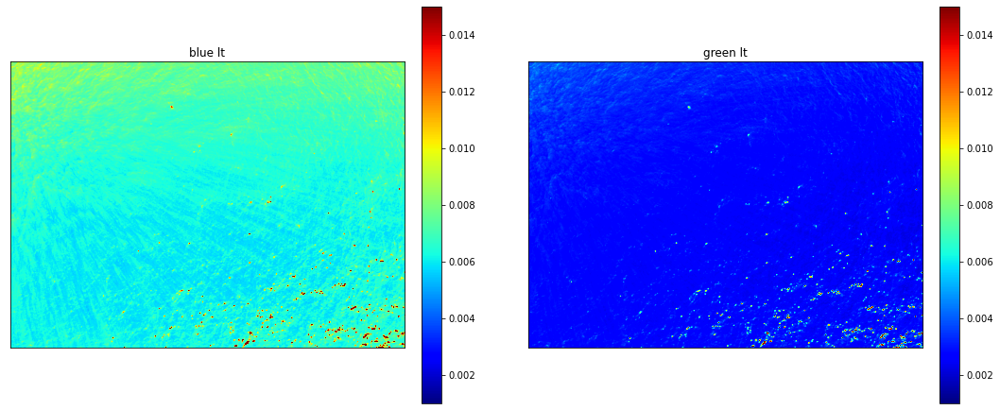

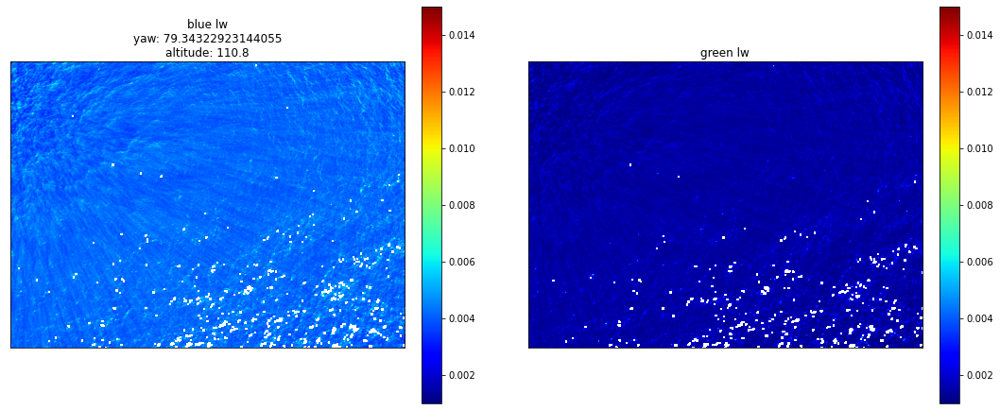

...

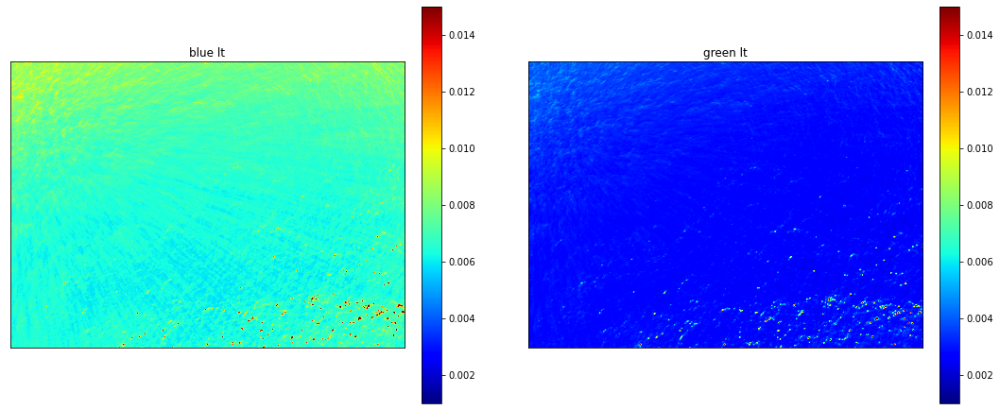

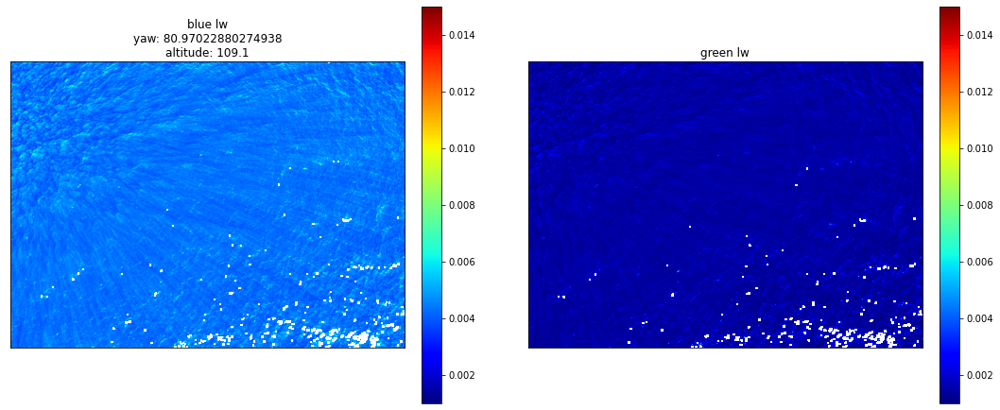

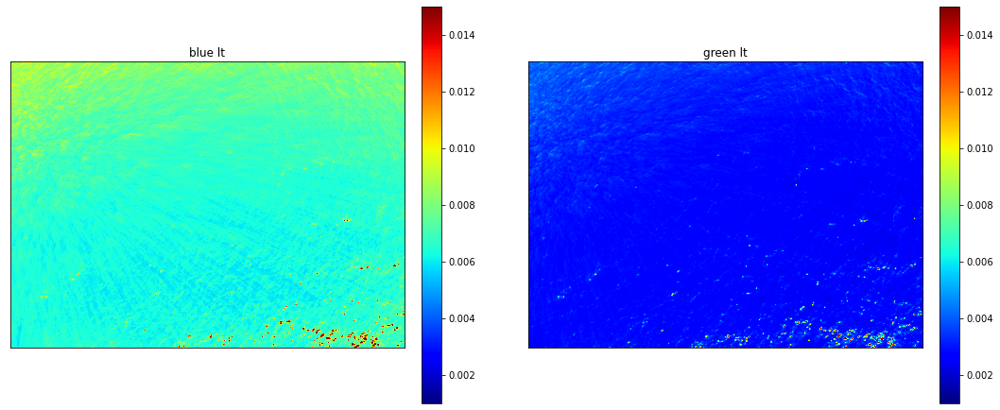

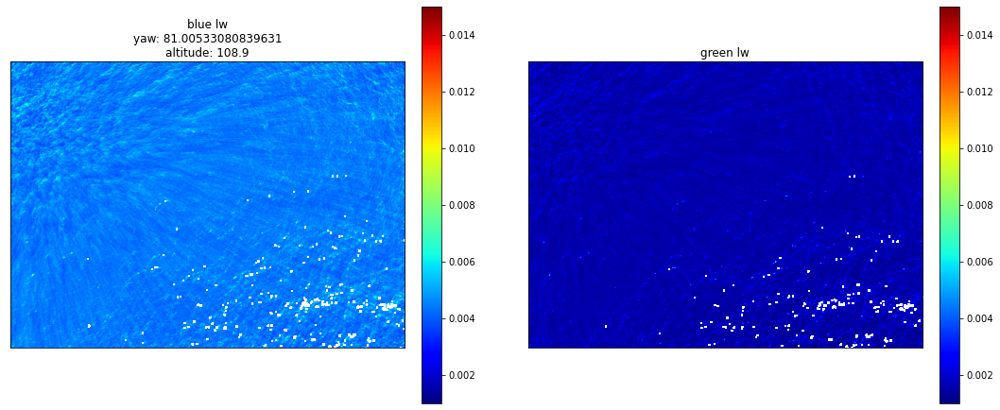

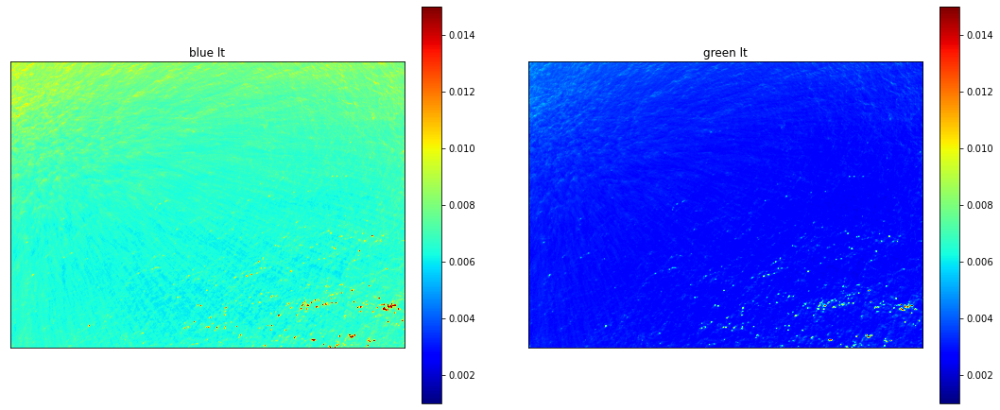

In [70]:
for i in range(20,35):
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
    img[img > 0.012] = np.nan
    
    
    im = ax[0].imshow(img[0],cmap='jet', vmin=0.001, vmax=.015)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw\nyaw: ' + str(sea_img_metadata[i]['yaw']) + '\naltitude: ' + str(sea_img_metadata[i]['Altitude']))
    im = ax[1].imshow(img[1],cmap='jet', vmin=0.001, vmax=.015)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()
    
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.001, vmax=.015)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lt')
    im = ax[1].imshow(sea_imgs[i, 1],cmap='jet', vmin=0.001, vmax=.015)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lt')
    plt.show()

In general this seems to remove the sky reflection and the glare pixels 

#### Inspect the spectra from this

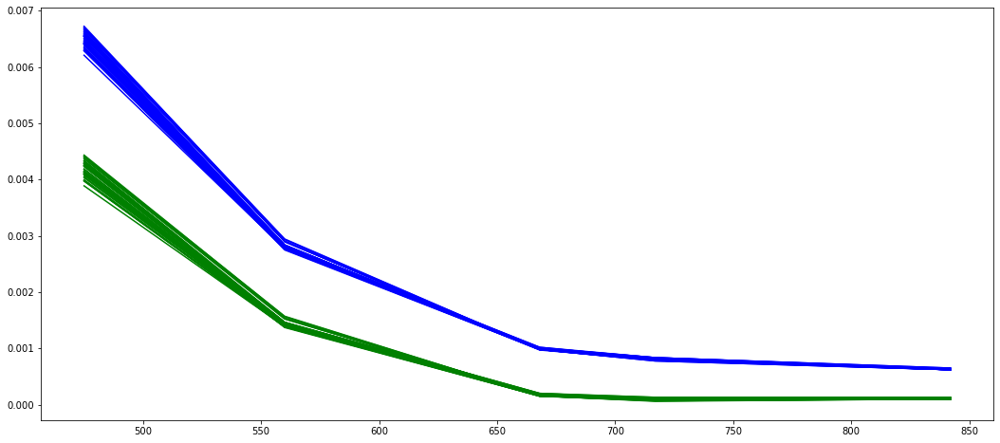

In [35]:
fig, ax = plt.subplots(figsize=(18,8))

for i in range(0,40):
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
#    img[img > 0.055] = np.nan
    
    ax.plot([475, 560, 668, 717, 842],np.nanmedian(img,axis=(1,2)), color='green')
    ax.plot([475, 560, 668, 717, 842],np.nanmedian(sea_imgs[i,:5],axis=(1,2)), color='blue')

### Running analysis on all data

See the shift to more normal distributions after the corrections.

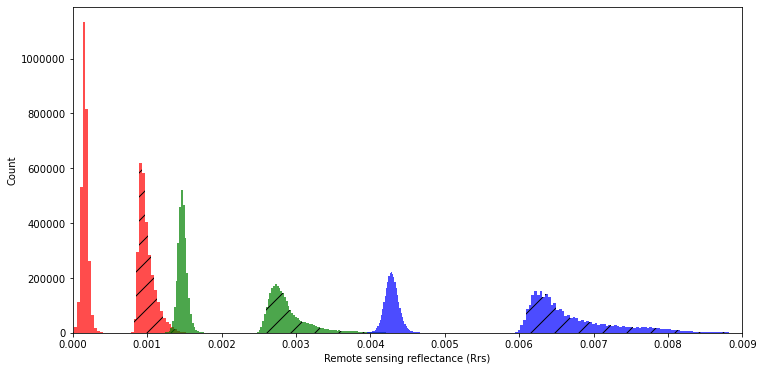

In [36]:
fig, ax = plt.subplots(figsize=(12,6))
ax.hist(sea_median[0,:,:].flatten(), bins=100, color='blue', hatch='/',alpha=0.7,)
ax.hist(sea_median[1,:,:].flatten(), bins=100, color='green', hatch='/',alpha=0.7)
ax.hist(sea_median[2,:,:].flatten(), bins=100, color='red',hatch='/',alpha=0.7)

ax.hist((sea_median[0,:,:]-smoothed_lt_lw[0]).flatten(), bins=100, color='blue', alpha=0.7)
ax.hist((sea_median[1,:,:]-smoothed_lt_lw[1]).flatten(), bins=100, color='green', alpha=0.7)
ax.hist((sea_median[2,:,:]-smoothed_lt_lw[2]).flatten(), bins=100, color='red', alpha=0.7)

ax.ticklabel_format(style='plain')
ax.set_ylabel('Count')
ax.set_xlabel('Remote sensing reflectance (Rrs)')

plt.xlim(0,0.009)
plt.savefig('oc_analysis_20210828_A2_gulf_stream_surveys_hist_lw_lt_sea_median.png')
plt.show()

#### Visualize chla output from current approach 

ocx median is:
0.27537083923073874


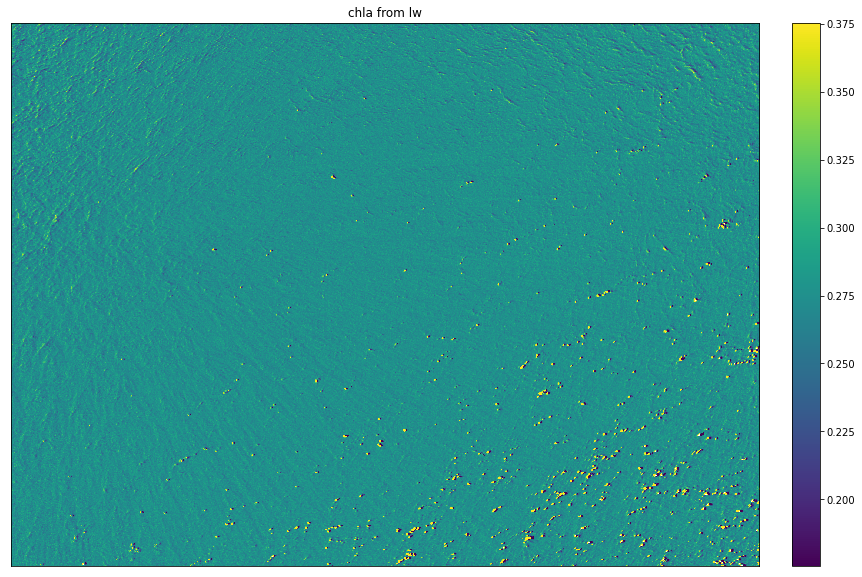

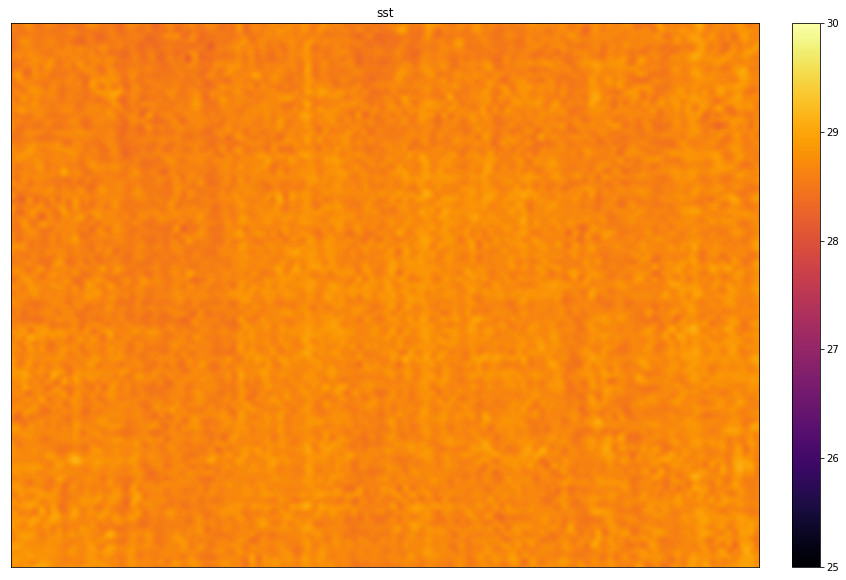

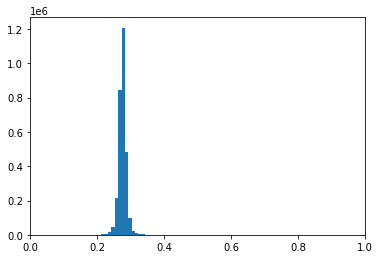

ocx median is:
0.2755952623929018


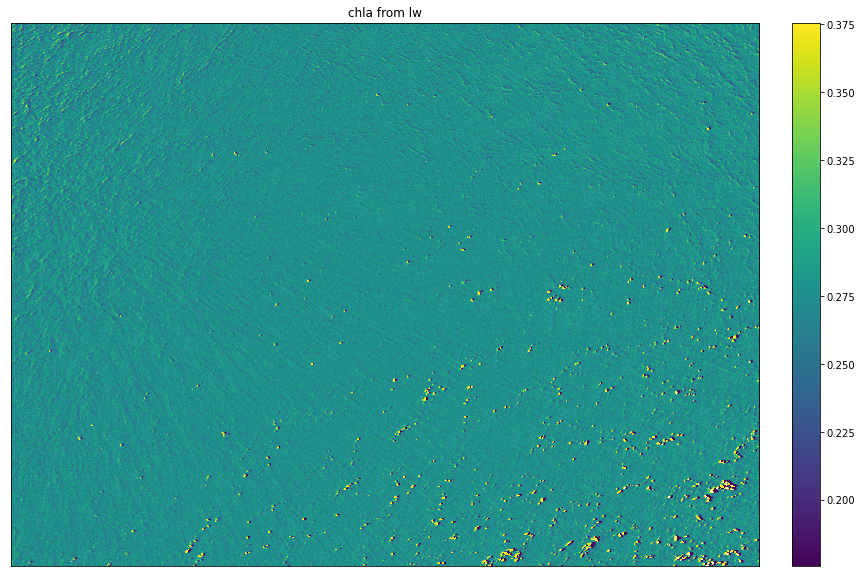

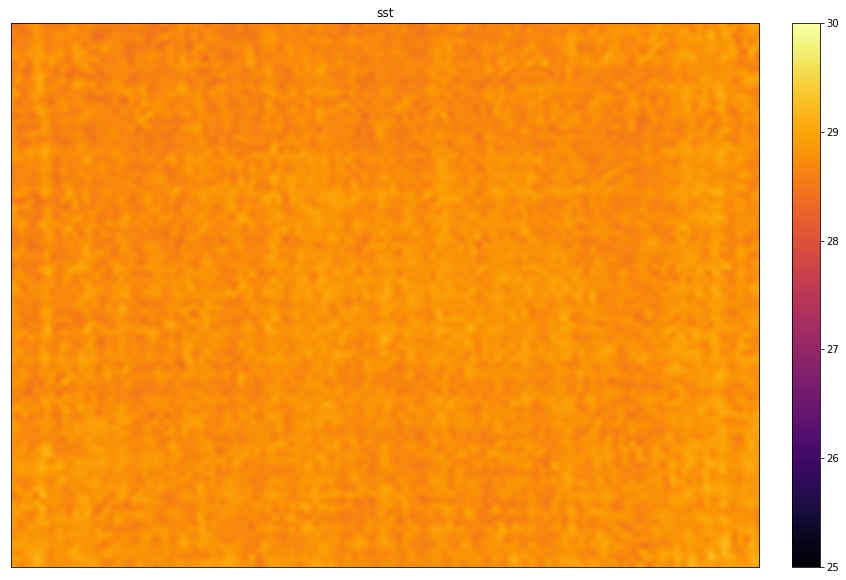

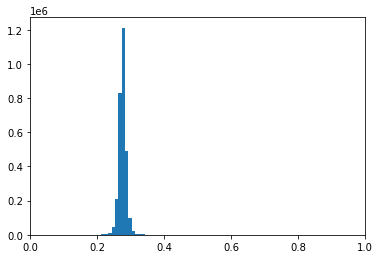

ocx median is:
0.2754335437133587


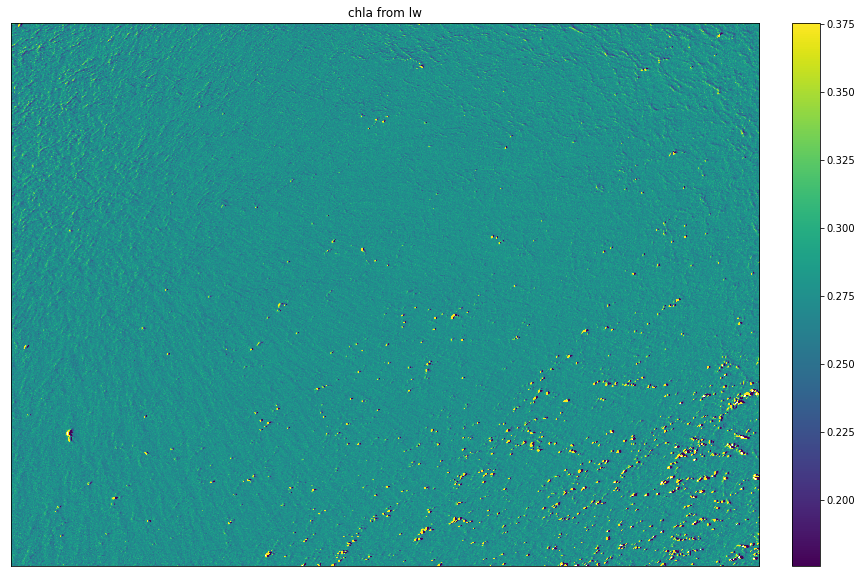

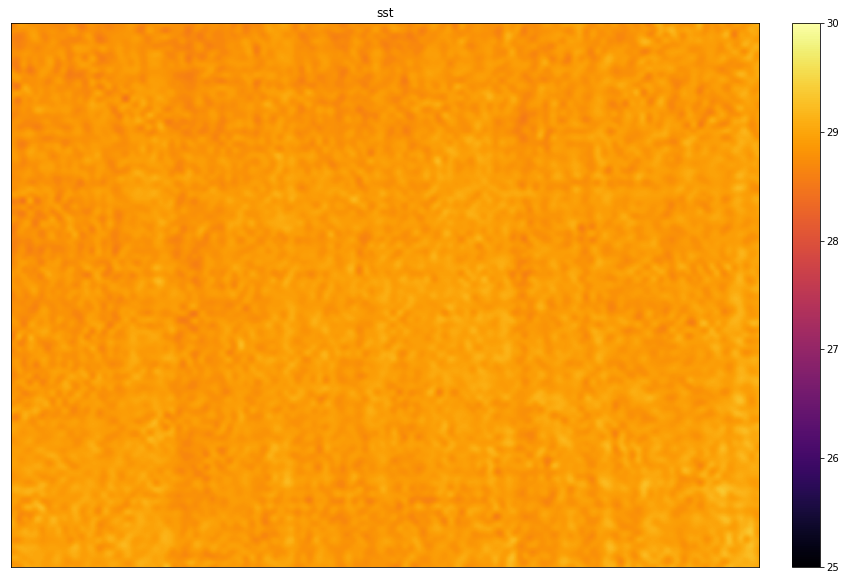

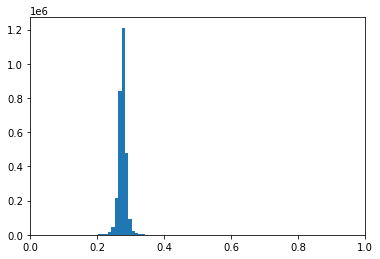

ocx median is:
0.2784010810364502


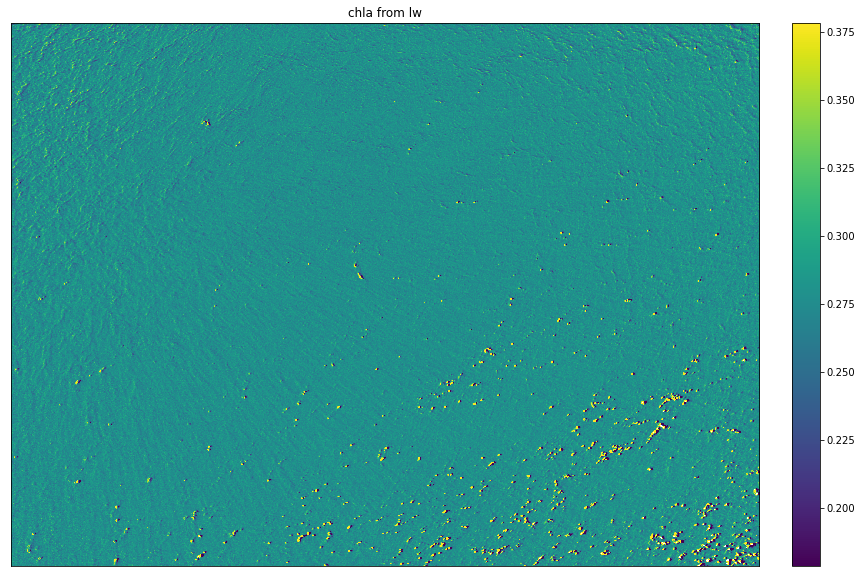

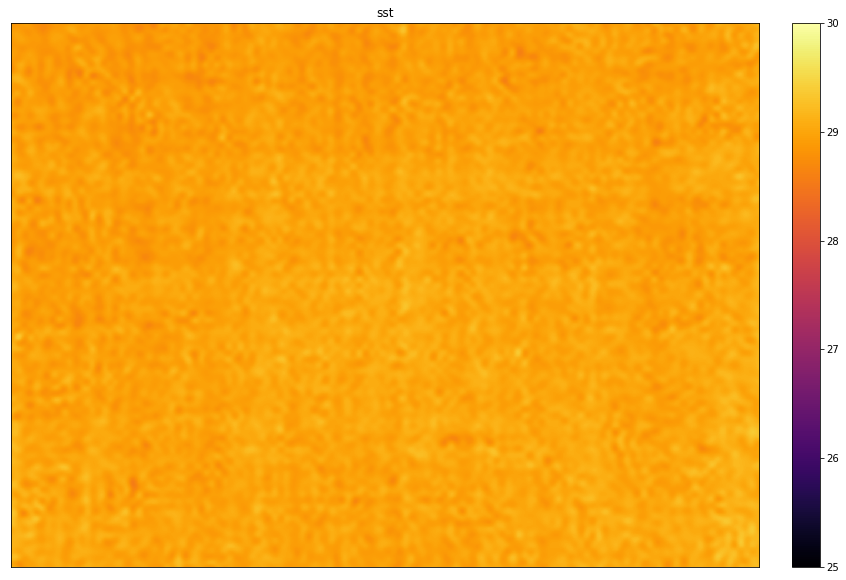

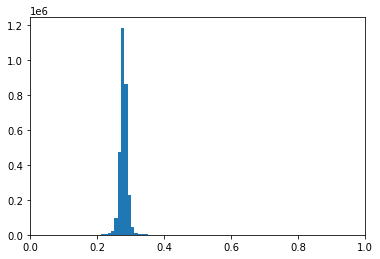

ocx median is:
0.2784689664171417


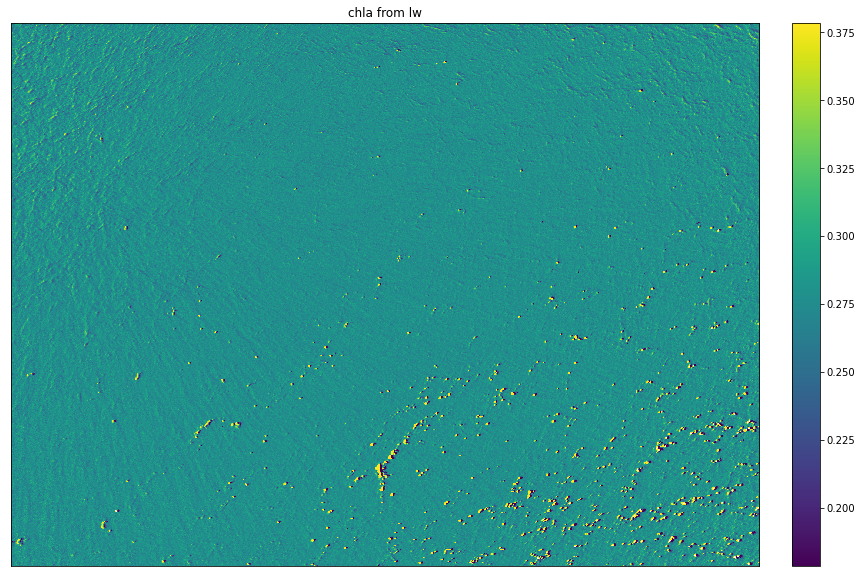

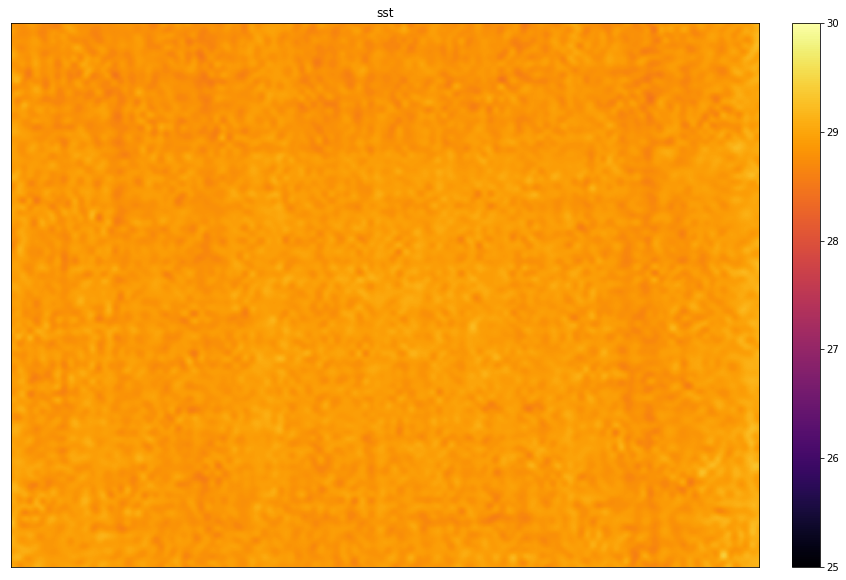

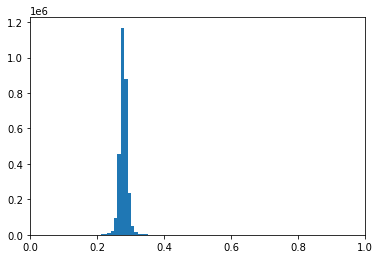

ocx median is:
0.27843547790101564


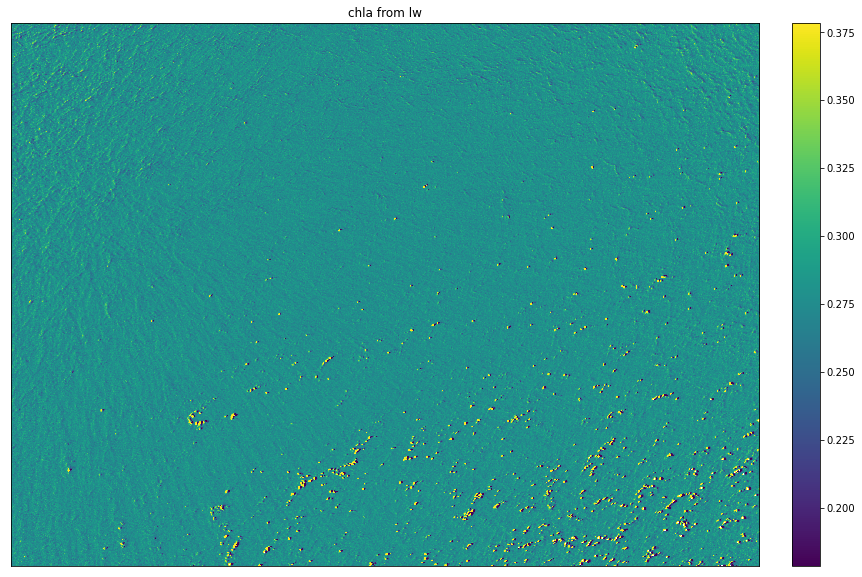

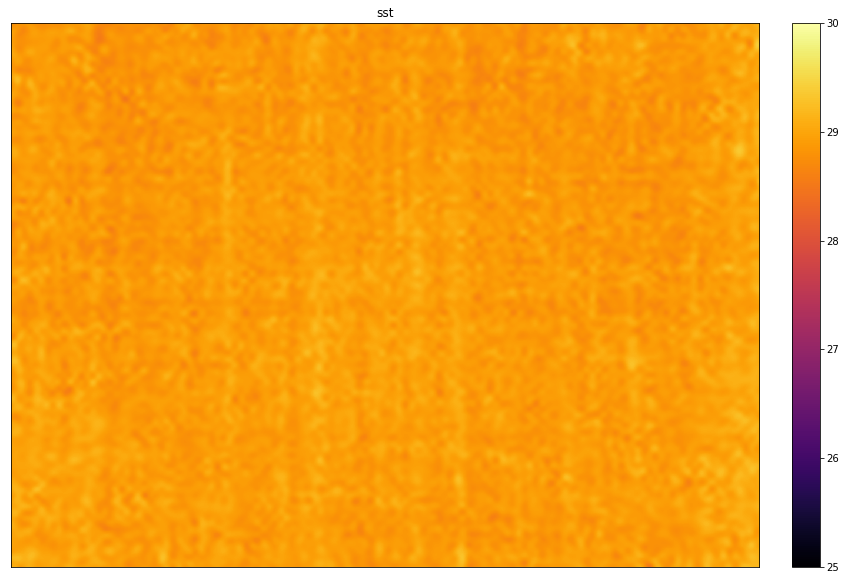

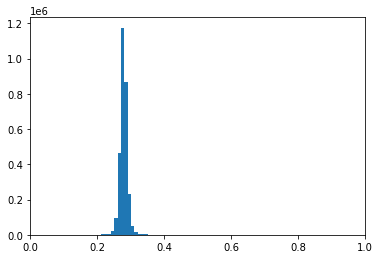

ocx median is:
0.2799902107628781


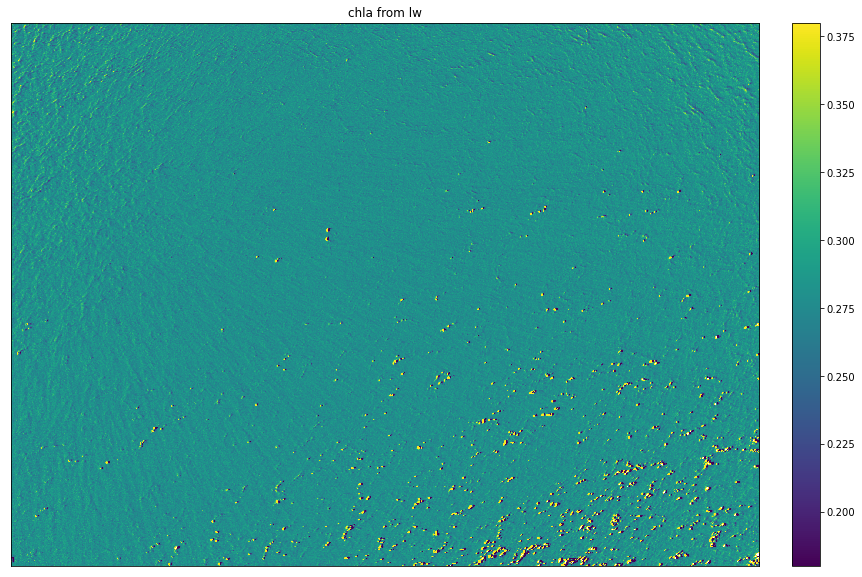

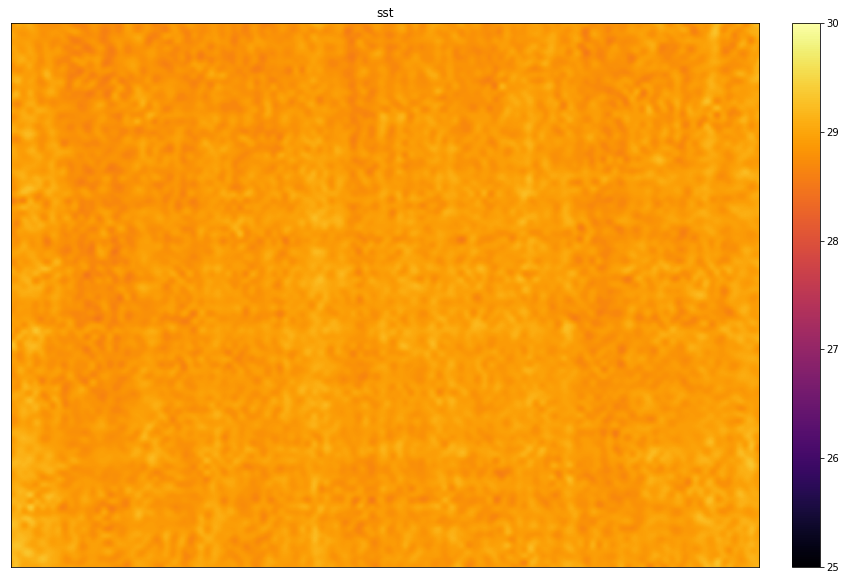

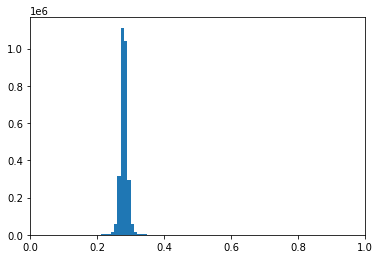

ocx median is:
0.27981957176334954


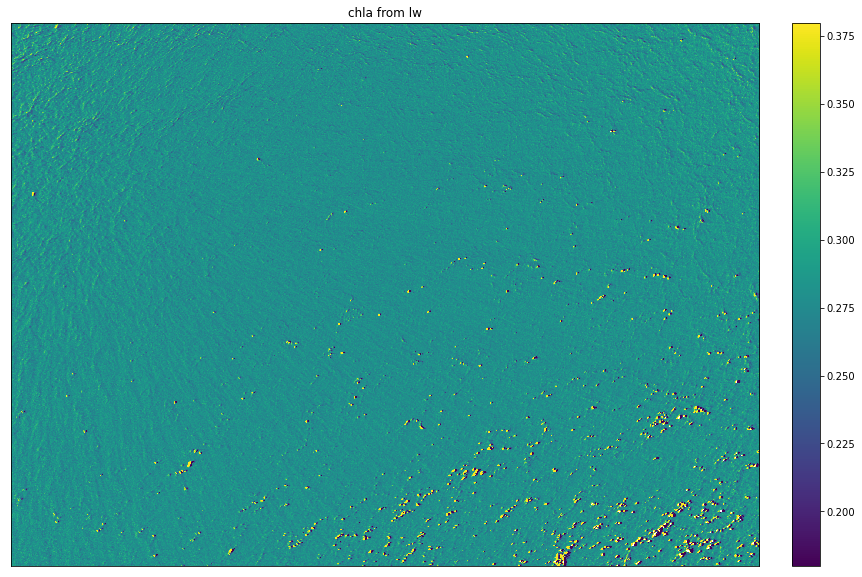

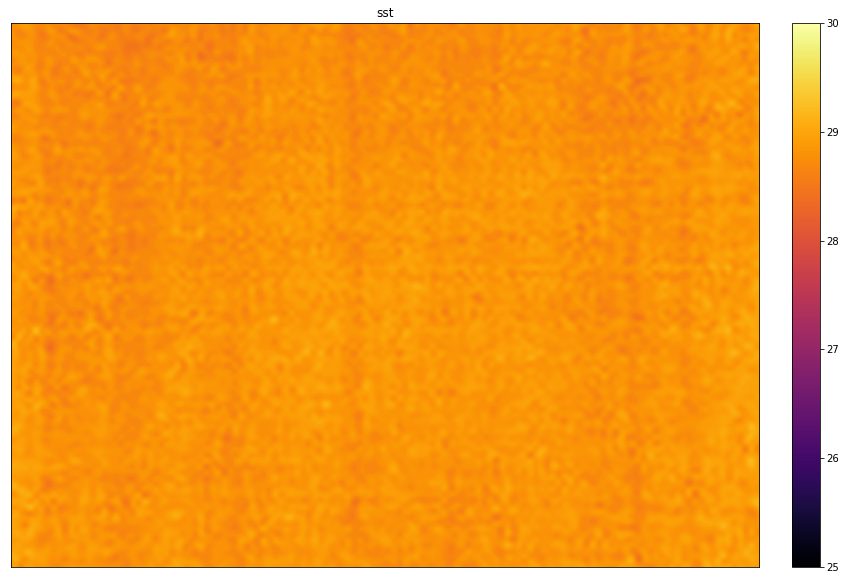

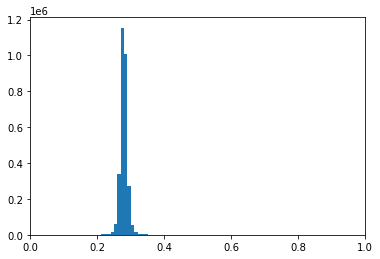

ocx median is:
0.2772725099124401


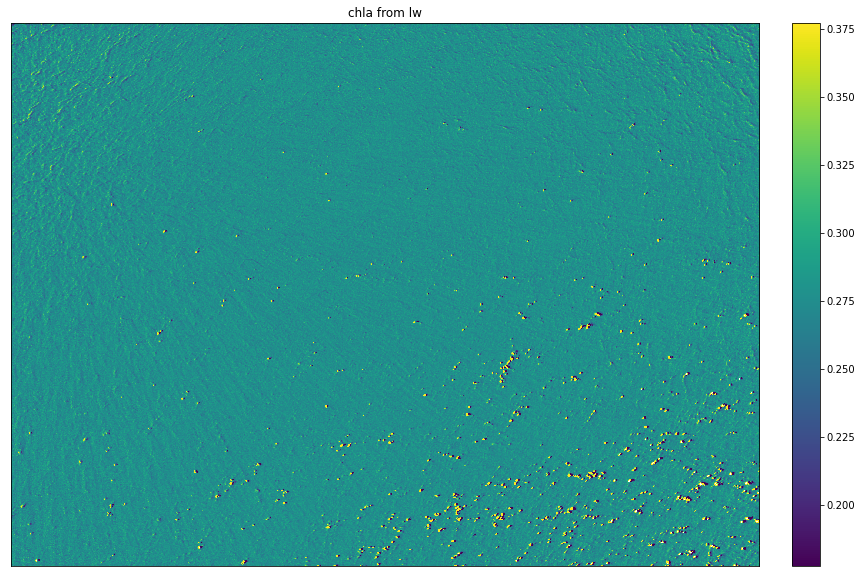

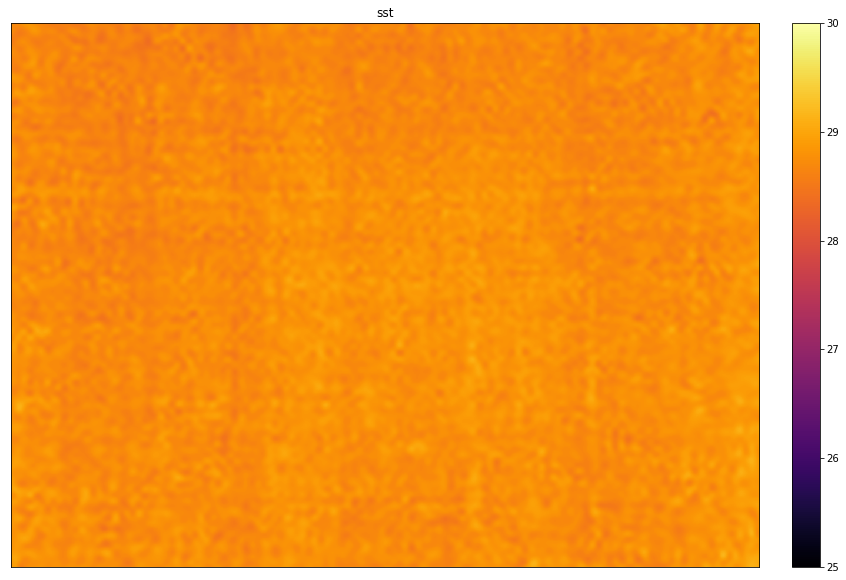

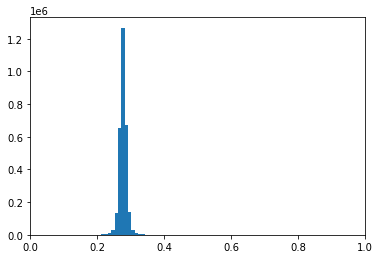

In [73]:
for i in range(1,10):
    
    img = sea_imgs[i,:5].copy() - smoothed_lt_lw
    #img[np.repeat((img[2] > 0.2)[np.newaxis,:,:],5,axis=0)] = np.nan
    img[np.repeat((img[0] < 0)[np.newaxis,:,:],5,axis=0)] = np.nan
        
    #chla_lw = vec_chla_img(img[0], img[1])
    #chla_lw = chla_lw[:500,:-1600]
    #img = img[:,:500,:-1600]    
    
    chla_oci = oc_index(img[0], img[1], img[2])
#     chla_oci = oc1_custom(img[0], img[1])
    chla_oci[chla_oci<0] = 0
    chla_oci[chla_oci>5] = np.nan
    
    img_median = np.nanmedian(img, axis=(1,2))
    print('ocx median is:')
    print(np.nanmedian(chla_oci))
    
    #print(vec_chla_img(img_median[0], img_median[1]))
    #print(np.nanmedian(chla_lw))
    fig, ax = plt.subplots(1, figsize=(15,10))
    im = ax.imshow(chla_oci,cmap='viridis', vmin=np.nanmedian(chla_oci)-.1, vmax=np.nanmedian(chla_oci)+.1, interpolation='none')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('chla from lw')
    plt.show()
    
    
    sst = sea_imgs[i,5]*math.pi*32768/100-273.15
    fig, ax = plt.subplots(1, figsize=(15,10))
    im = ax.imshow(sst,cmap='inferno', vmin=25, vmax=30, interpolation='none')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('sst')
    plt.show()
    
#     plt.hist(img[0].flatten(),bins=500)
#     plt.xlim(-.05,.05)
#     plt.show()
    
#     plt.hist(img[1].flatten(),bins=500)
#     plt.xlim(-.05,.05)
#     plt.show()

    plt.hist(chla_oci.flatten(), bins=500)
    plt.xlim(0,1)
    plt.show()


What does this look like slightly blurred?

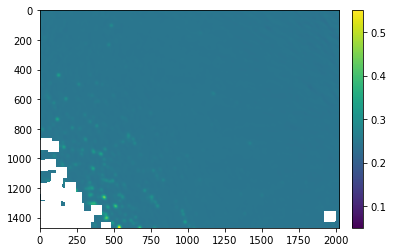

In [134]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(chla_oci, sigma=(9, 9), order=0), cmap='viridis', vmin=0.05, vmax=0.55, interpolation='none')
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Fill gaps just to see whole image

In [135]:
# TODO this is not the *ideal* solution
# make a mask where there are nans
mask = np.isnan(chla_oci)
# get the indices where the mask is not existant
idx = np.where(~mask,np.arange(mask.shape[1]),0)
np.maximum.accumulate(idx,axis=1, out=idx)
out = chla_oci[np.arange(idx.shape[0])[:,None], idx]

In [136]:
from scipy import interpolate
#mask invalid values
x = np.arange(0, chla_oci.shape[1])
y = np.arange(0, chla_oci.shape[0])
array = np.ma.masked_invalid(chla_oci)
xx, yy = np.meshgrid(x, y)
#get only the valid values
x1 = xx[~array.mask]
y1 = yy[~array.mask]
newarr = array[~array.mask]

GD1 = interpolate.griddata((x1, y1), newarr.ravel(),
                          (xx, yy),
                             method='nearest')

In [137]:
GD1.shape

(1470, 2023)

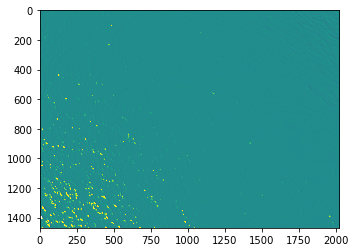

In [138]:
plt.imshow(out,cmap='viridis', vmin=0, vmax=.5)

Create a movie of all the data to watch change over time

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

KeyboardInterrupt: 

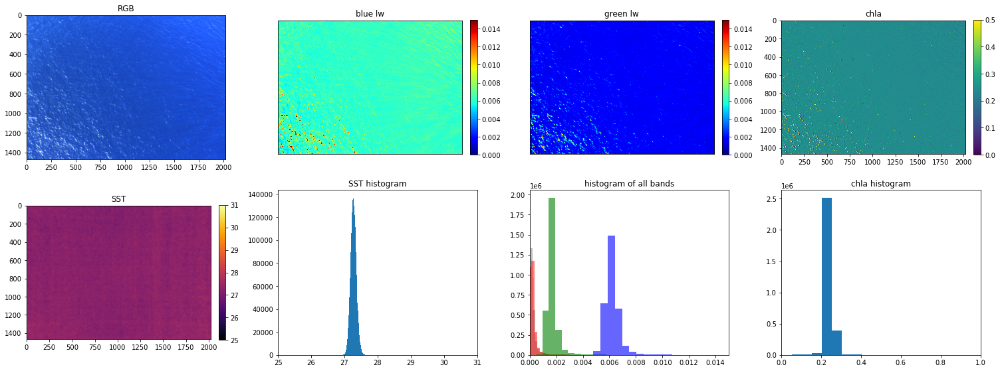

In [196]:
for i in range(90,len(mds)):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    sst=img[0,5]*math.pi*32768/100-273.15
    
    fig,ax = plt.subplots(2,4,figsize=(21,8))
    
    # RGB, blue, green, chla
    ax[0,0].imshow((np.transpose(img[0,0:3]/0.01, (1,2,0))[:,:,::-1]))
    ax[0,0].set_title('RGB')
    
    img = img[0,:5,:,:] - smoothed_lt_lw
    chla_img = oc_index(img[0], img[1], img[2])
#     chla_img = oc1_custom(img[0], img[1])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>5] = np.nan
    #chla_img[chla_img<1] = np.nan
    
    im = ax[0,1].imshow(img[0],cmap='jet', vmin=0.0, vmax=.015)
    fig.colorbar(im, ax=ax[0,1], fraction=0.034, pad=0.04)
    ax[0,1].set_xticks([])
    ax[0,1].set_yticks([])
    ax[0,1].set_title('blue lw')
    im = ax[0,2].imshow(img[1],cmap='jet', vmin=0.0, vmax=.015)
    fig.colorbar(im, ax=ax[0,2], fraction=0.034, pad=0.04)
    ax[0,2].set_xticks([])
    ax[0,2].set_yticks([])
    ax[0,2].set_title('green lw')
    

    
    im = ax[0,3].imshow(chla_img, vmin=0,vmax=.5, interpolation='none')
    fig.colorbar(im, ax=ax[0,3], fraction=0.034, pad=0.04)
    ax[0,3].set_title('chla')
    
    # SST, SST hist, all bands hist, chla hist
    
    
    im = ax[1,0].imshow(sst,cmap='inferno', vmax=25,vmin=31)
    fig.colorbar(im, ax=ax[1,0], fraction=0.034, pad=0.04)
    ax[1,0].set_title('SST')
    
    ax[1,1].hist(sst.flatten(), bins=80)
    ax[1,1].set_xlim(25,31)
    ax[1,1].set_title('SST histogram')
    
    
    
    ax[1,2].hist((img[4]).flatten(), bins=100, color='rosybrown', alpha=0.2)
    ax[1,2].hist((img[3]).flatten(), bins=100, color='grey', alpha=0.5)
    ax[1,2].hist((img[2]).flatten(), bins=100, color='red', alpha=0.5)
    ax[1,2].hist((img[1]).flatten(), bins=100, color='green', alpha=0.6)
    ax[1,2].hist((img[0]).flatten(), bins=100, color='blue', alpha=0.6)
    ax[1,2].set_xlim(0,0.015)
    ax[1,2].set_title('histogram of all bands')
    
    ax[1,3].hist(chla_img.flatten(), bins=100)
    ax[1,3].set_xlim(0,1)
    ax[1,3].set_title('chla histogram')
    fig.tight_layout()
    
#     plt.show()

    fig.savefig('data/210827_A1_frontcross1/anims/full_analysis/img_sst_hist_bkg'+str(i).zfill(4)+'.png', 
                facecolor='white', edgecolor='none', transparent=False)   # save the figure to file
    fig.clear()
    plt.close(fig)  
    
    del img
    del sst
    del chla_img

##### Inspect the data geographically

Turn each image to a point and put it into a gdf

In [37]:
lats = []
lons = []
chla_list = []
chla_dates = []
temps = []
spectras = []
for i in range(50,len(mds)-50):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    
    sst = img[0,5]
    sst_in_k = np.median(sst) *math.pi* 32768 / 100-273.15
#     plt.imshow(sst* 32768 / 100, vmin=288,vmax=292)
#     print(sst_in_k)
#     plt.show()
    
    img = img[0,:5,:,:] - smoothed_lt_lw
    #img = sea_imgs[i,:5].copy() 
    #img[np.repeat((img[2] > 0.0075)[np.newaxis,:,:],5,axis=0)] = np.nan
    chla_img = oc_index(img[0], img[1], img[2])
#     chla_img = oc1_custom(img[0], img[1])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>5] = np.nan
    chla_med = np.nanmedian(chla_img)
    #img_median = np.nanmedian(img, axis=(1,2))
    #oc_med = oc_index(img_median[0], img_median[1], img_median[2])
    #oc_med = vec_chla_img(img_median[0], img_median[1])
    
    spectras.append(np.median(img,axis=[1,2]))

    chla_list.append(chla_med)
    lats.append(mds[i]['Latitude'])
    lons.append(mds[i]['Longitude'])
    chla_dates.append(datetime.datetime.strptime(mds[i]['Date']+' - '+mds[i]['UTC-Time'], '%m/%d/%Y - %H:%M:%S'))
    temps.append(sst_in_k)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/rasterio/__init__.py:207: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [38]:
len(chla_list)

188

<AxesSubplot:>

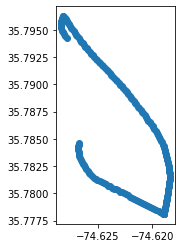

In [39]:
import geopandas as gpd
chla_df = pd.DataFrame(
    {'chla': chla_list,
     'Latitude': lats,
     'Longitude': lons,
     'time' : chla_dates,
     'sst' : temps,
     'lw_spectra': spectras
    })

chla_gdf = gpd.GeoDataFrame(
    chla_df, geometry=gpd.points_from_xy(chla_df.Longitude, chla_df.Latitude))
chla_gdf.plot()

<AxesSubplot:>

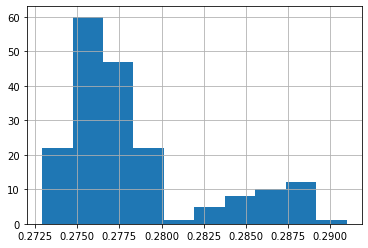

In [79]:
chla_gdf['chla'].hist()

<AxesSubplot:>

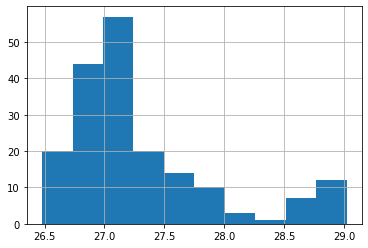

In [80]:
chla_gdf['sst'].hist()

In [81]:
chla_gdf_short = chla_gdf.iloc[:150]

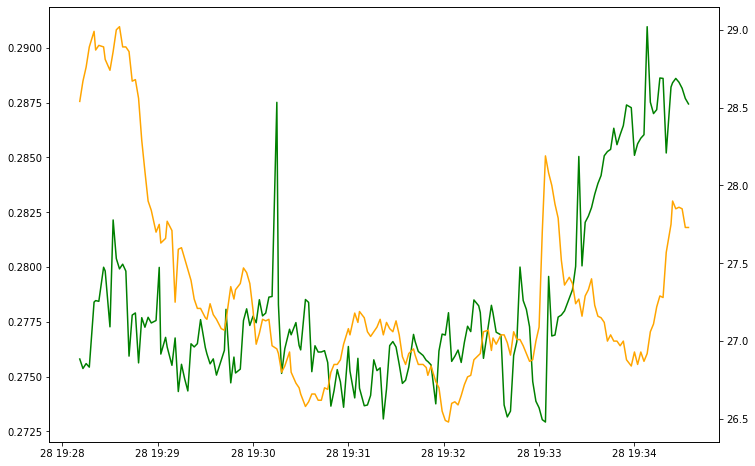

In [82]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.time, chla_gdf.chla, color='green')
ax2=ax.twinx()
ax2.plot(chla_gdf.time, chla_gdf.sst, color='orange')

In [83]:
chla_gdf

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.275804,35.784628,-74.626711,2021-08-28 19:28:11,28.54,"[0.004250132761414206, 0.0014477659671346182, ...",POINT (-74.62671 35.78463)
1,0.275371,35.784467,-74.626747,2021-08-28 19:28:13,28.67,"[0.004288784231516544, 0.001464151880102492, 0...",POINT (-74.62675 35.78447)
2,0.275595,35.784306,-74.626783,2021-08-28 19:28:15,28.76,"[0.004280222116292979, 0.0014614242634109354, ...",POINT (-74.62678 35.78431)
3,0.275434,35.784122,-74.626811,2021-08-28 19:28:17,28.89,"[0.0042753648593505745, 0.0014562709673825677,...",POINT (-74.62681 35.78412)
4,0.278401,35.783936,-74.626803,2021-08-28 19:28:20,28.99,"[0.004130566677051339, 0.0014398770108383098, ...",POINT (-74.62680 35.78394)
...,...,...,...,...,...,...,...
183,0.288604,35.794922,-74.628264,2021-08-28 19:34:26,27.85,"[0.003747727993998063, 0.0014713802235489933, ...",POINT (-74.62826 35.79492)
184,0.288431,35.794750,-74.628186,2021-08-28 19:34:28,27.86,"[0.0037380481412722056, 0.0014592220244245965,...",POINT (-74.62819 35.79475)
185,0.288153,35.794583,-74.628094,2021-08-28 19:34:30,27.85,"[0.0037274290259332156, 0.0014462677743143472,...",POINT (-74.62809 35.79458)
186,0.287690,35.794422,-74.627992,2021-08-28 19:34:32,27.73,"[0.0037401868435265446, 0.001443953781828745, ...",POINT (-74.62799 35.79442)


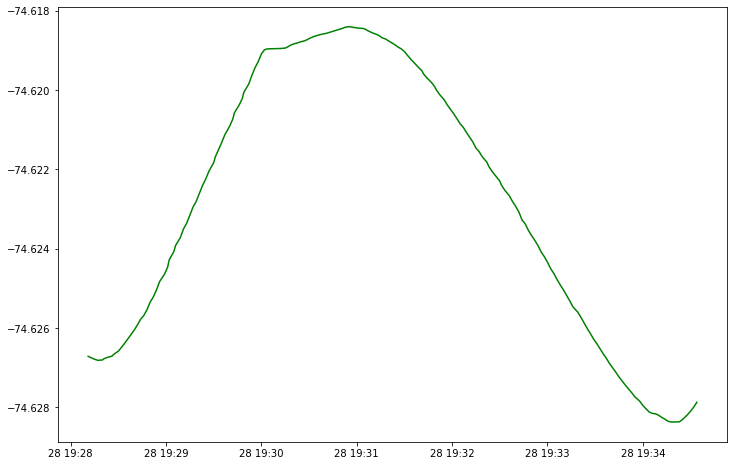

In [84]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='green')
# ax.plot(chla_gdf.time, chla_gdf.sst, color='orange')

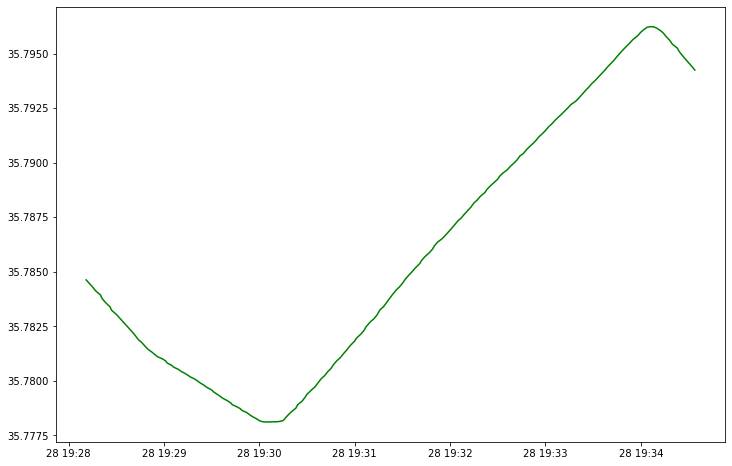

In [85]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Latitude, color='green')
# ax.plot(chla_gdf.time, chla_gdf.sst, color='orange')

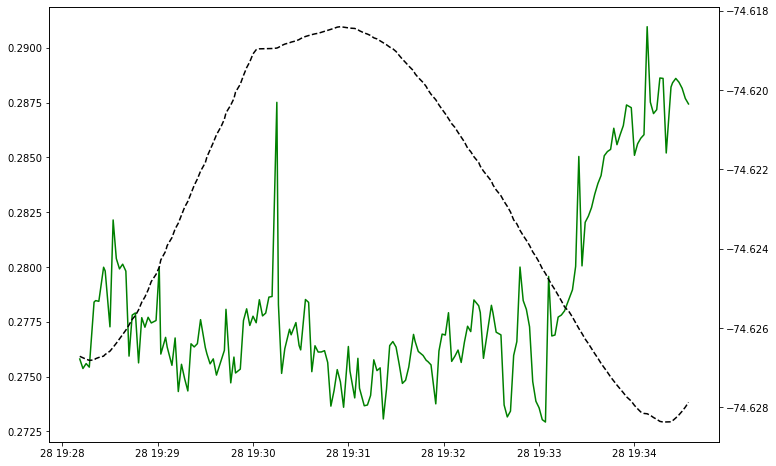

In [86]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].chla, color='green')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='black', ls='--')


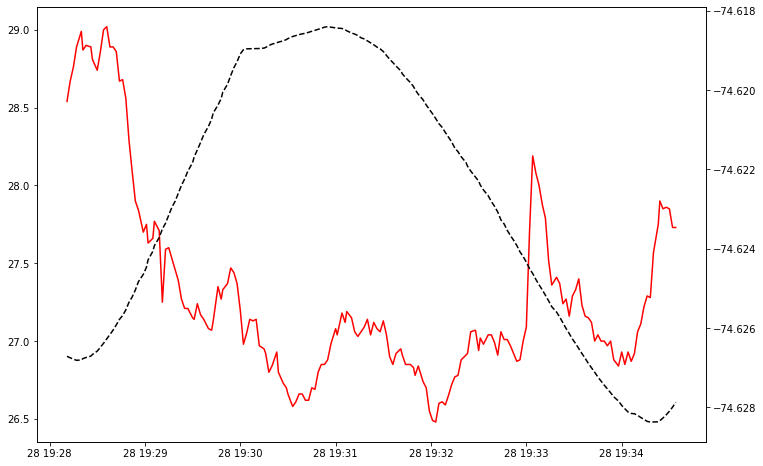

In [87]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].sst, color='red')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='black', ls='--')

<AxesSubplot:>

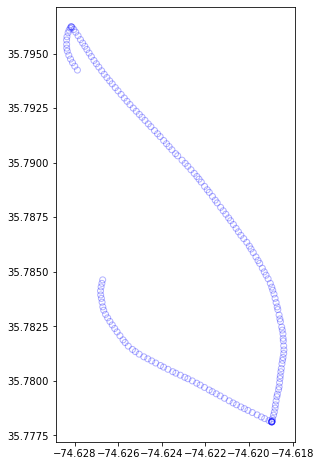

In [88]:
fig, ax = plt.subplots(figsize=(12,8))
chla_gdf.plot(alpha=0.3, ax=ax, facecolor='None', edgecolor='blue')

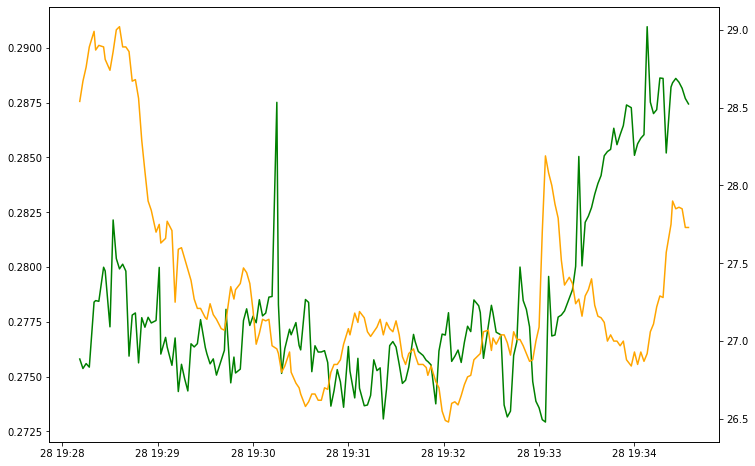

In [89]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:230].time, chla_gdf.iloc[:230].chla, color='green')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:230].time, chla_gdf.iloc[:230].sst, color='orange')

<AxesSubplot:>

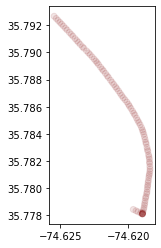

In [90]:
chla_gdf.iloc[50:150].plot('chla',vmin=0.23, vmax=.26, cmap='jet', alpha=0.1)

<AxesSubplot:>

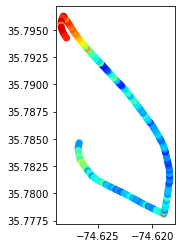

In [94]:
chla_gdf.iloc[:].plot('chla',vmin=0.27, vmax=.29, cmap='jet')

<AxesSubplot:>

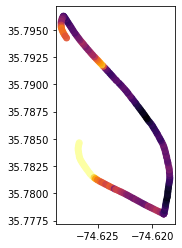

In [98]:
chla_gdf.iloc[0:].plot(column='sst',vmin=26.5, vmax=28.5, cmap='inferno', alpha=0.9)

<AxesSubplot:>

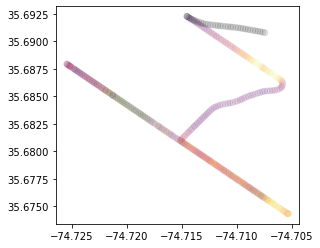

In [156]:
chla_gdf.plot(column=chla_gdf['sst'],vmin=25.5, vmax=27.5, cmap='inferno', alpha=0.1)

In [141]:
chla_gdf.head()

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry,time_str
0,0.275804,35.784628,-74.626711,2021-08-28 19:28:11,28.54,"[0.004250132761414206, 0.0014477659671346182, ...",POINT (-74.62671 35.78463),2021-08-28 19:28:11
1,0.275371,35.784467,-74.626747,2021-08-28 19:28:13,28.67,"[0.004288784231516544, 0.001464151880102492, 0...",POINT (-74.62675 35.78447),2021-08-28 19:28:13
2,0.275595,35.784306,-74.626783,2021-08-28 19:28:15,28.76,"[0.004280222116292979, 0.0014614242634109354, ...",POINT (-74.62678 35.78431),2021-08-28 19:28:15
3,0.275434,35.784122,-74.626811,2021-08-28 19:28:17,28.89,"[0.0042753648593505745, 0.0014562709673825677,...",POINT (-74.62681 35.78412),2021-08-28 19:28:17
4,0.278401,35.783936,-74.626803,2021-08-28 19:28:20,28.99,"[0.004130566677051339, 0.0014398770108383098, ...",POINT (-74.62680 35.78394),2021-08-28 19:28:20


### Write out the data as .tifs

This step reprojects the data and georegisters it.

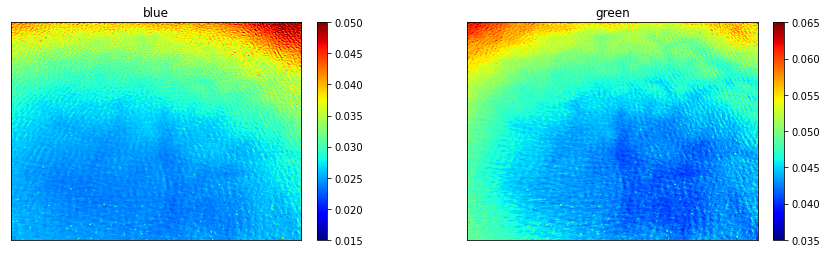

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


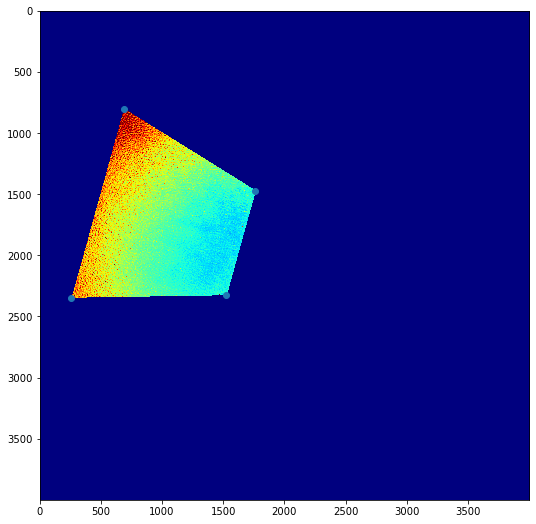

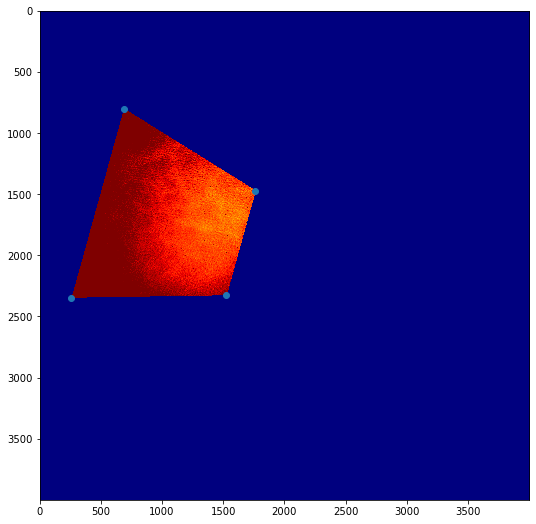

In [59]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-100,100,-100,100]
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    resized_blue[resized_blue < 0] = 0
    resized_green[resized_green < 0] = 0
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

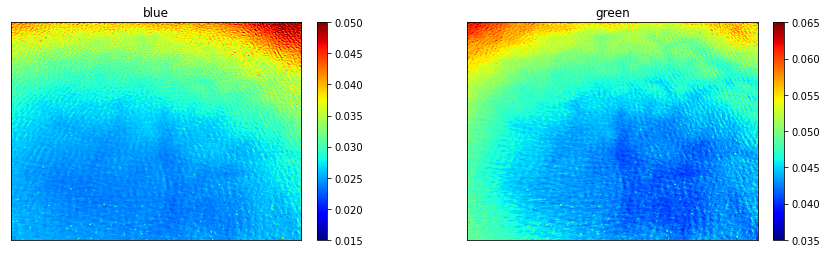

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!
34.7138816 -76.6757056 47.83 -74.5 0 40
0.05


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


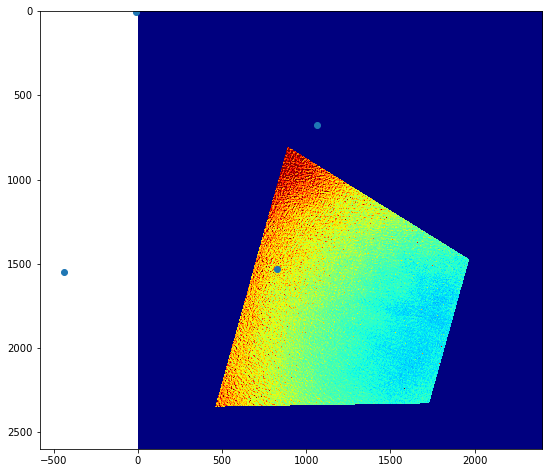

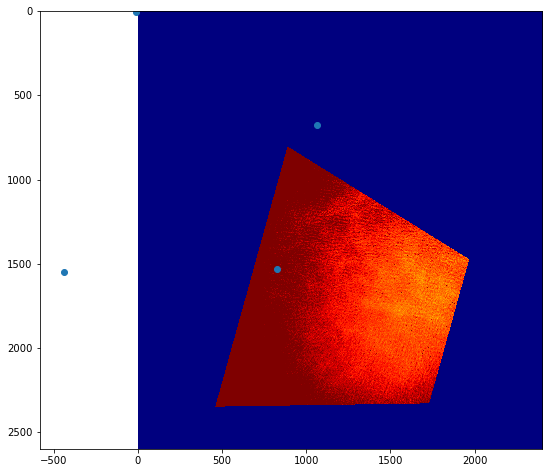

In [58]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-110,10,-30,100]
    x_center_offset = 10 - 110 / 0.05
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

## compare this to the Trios Data

If the data exists, otherwise skip or delete this section.

First find the start and stop time of the UAS imagery.

In [102]:
from datetime import datetime
import geopandas as gpd
import pandas as pd

In [103]:
def dms2dd(degrees, minutes, seconds, direction):
    dd = degrees + minutes/60 + seconds/(60*60);
    if direction == 'W' or direction == 'S':
        dd *= -1
    return dd;

In [104]:
ship_df = pd.read_csv('../gs_front_analysis/data/ivan_data/tsg_gps/Navigation/SW-GGA_20210825-082425.Raw', index_col=None,
                 names=['date', 'time','spacer', 'idk', 'SW-GGA-Lat','latdir', 'SW-GGA-Long', 'londir', 'a','b','c','d','e','f','g'])

date_time_strs = ship_df['date'] + ' ' + ship_df['time']

ship_df['datetime'] = [datetime.strptime(x, '%m/%d/%Y %H:%M:%S.%f') for x in date_time_strs]
ship_df['utc_dt'] = ship_df['datetime']+ timedelta(minutes=4)
ship_df  = ship_df.set_index('utc_dt')

ship_df['lon'] = dms2dd(pd.to_numeric(ship_df['SW-GGA-Long'].astype(str).str[:2]).astype(float), pd.to_numeric(ship_df['SW-GGA-Long'].astype(str).str[2:]),np.array(0), 'W')
ship_df['lat'] = dms2dd(pd.to_numeric(ship_df['SW-GGA-Lat'].astype(str).str[:2]).astype(float), pd.to_numeric(ship_df['SW-GGA-Lat'].astype(str).str[2:]),np.array(0), 'E')


ship_gdf = gpd.GeoDataFrame(
    ship_df, geometry=gpd.points_from_xy(ship_df.lon, ship_df.lat))

In [105]:
ship_gdf.head()

,date,time,spacer,idk,SW-GGA-Lat,latdir,SW-GGA-Long,londir,a,b,c,d,e,f,g,datetime,lon,lat,geometry
utc_dt,,,,,,,,,,,,,,,,,,,
2021-08-25 08:28:30.412,08/25/2021,08:24:30.412,$GPGGA,82741.69,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*43,2021-08-25 08:24:30.412,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:31.506,08/25/2021,08:24:31.506,$GPGGA,82742.69,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*40,2021-08-25 08:24:31.506,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:32.287,08/25/2021,08:24:32.287,$GPGGA,82743.70,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*79,2021-08-25 08:24:32.287,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:33.709,08/25/2021,08:24:33.709,$GPGGA,82744.70,3443.0547,N,7640.2342,W,2,29,0.5,-28.5,M,-36.8,M*7F,2021-08-25 08:24:33.709,-76.670570,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:34.631,08/25/2021,08:24:34.631,$GPGGA,82745.70,3443.0547,N,7640.2342,W,2,28,0.5,-28.4,M,-36.8,M*7E,2021-08-25 08:24:34.631,-76.670570,34.717578,POINT (-76.67057 34.71758)


<AxesSubplot:>

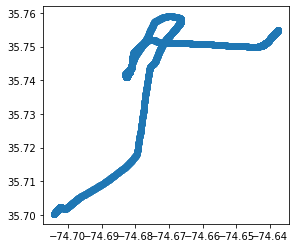

In [106]:
ship_gdf.loc['2021-08-27 15:05:27':'2021-08-27 15:50:47'].plot()

In [107]:
chla_gdf

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry,time_str
0,0.275804,35.784628,-74.626711,2021-08-28 19:28:11,28.54,"[0.004250132761414206, 0.0014477659671346182, ...",POINT (-74.62671 35.78463),2021-08-28 19:28:11
1,0.275371,35.784467,-74.626747,2021-08-28 19:28:13,28.67,"[0.004288784231516544, 0.001464151880102492, 0...",POINT (-74.62675 35.78447),2021-08-28 19:28:13
2,0.275595,35.784306,-74.626783,2021-08-28 19:28:15,28.76,"[0.004280222116292979, 0.0014614242634109354, ...",POINT (-74.62678 35.78431),2021-08-28 19:28:15
3,0.275434,35.784122,-74.626811,2021-08-28 19:28:17,28.89,"[0.0042753648593505745, 0.0014562709673825677,...",POINT (-74.62681 35.78412),2021-08-28 19:28:17
4,0.278401,35.783936,-74.626803,2021-08-28 19:28:20,28.99,"[0.004130566677051339, 0.0014398770108383098, ...",POINT (-74.62680 35.78394),2021-08-28 19:28:20
...,...,...,...,...,...,...,...,...
183,0.288604,35.794922,-74.628264,2021-08-28 19:34:26,27.85,"[0.003747727993998063, 0.0014713802235489933, ...",POINT (-74.62826 35.79492),2021-08-28 19:34:26
184,0.288431,35.794750,-74.628186,2021-08-28 19:34:28,27.86,"[0.0037380481412722056, 0.0014592220244245965,...",POINT (-74.62819 35.79475),2021-08-28 19:34:28
185,0.288153,35.794583,-74.628094,2021-08-28 19:34:30,27.85,"[0.0037274290259332156, 0.0014462677743143472,...",POINT (-74.62809 35.79458),2021-08-28 19:34:30
186,0.287690,35.794422,-74.627992,2021-08-28 19:34:32,27.73,"[0.0037401868435265446, 0.001443953781828745, ...",POINT (-74.62799 35.79442),2021-08-28 19:34:32


Pull in the trios data based on that day.

In [110]:
trios_fns = [
    '../gs_front_analysis/data/ivan_data/trios/shearwater_trios_20210828.csv',

            ]
trios_dfs = []
for fn in trios_fns:
    trios_dfs.append(pd.read_csv(fn))

trios_df = pd.DataFrame().append(trios_dfs)

Combine the Ship GPS with TriOS based on time

In [111]:
trios_df['datetime'] = pd.to_datetime(trios_df['TimeStamp'])
trios_df['datetime'] = trios_df['datetime'] + timedelta(hours=4)
trios_df['utc_dt'] =trios_df['datetime'] + timedelta(hours=4) # moving it to UTC
trios_df = trios_df.set_index('utc_dt')

In [112]:
lats = []
lons = []
for i in range(len(trios_df)):
    item = trios_df.iloc[i]
    img_idx = ship_gdf.index.get_loc(item['datetime'] + timedelta(hours=4), method='nearest')
    lats.append(ship_gdf.iloc[img_idx]['lat'])
    lons.append(ship_gdf.iloc[img_idx]['lon'])

In [113]:
trios_df['lat'] = lats
trios_df['lon'] = lons

<AxesSubplot:>

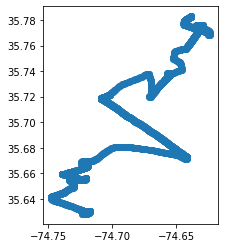

In [114]:
trios_gdf = gpd.GeoDataFrame(
    trios_df, geometry=gpd.points_from_xy(trios_df.lon, trios_df.lat))
trios_gdf.plot()

In [115]:
trios_gdf

,TimeStamp,320,321,322,323,324,325,326,327,328,...,945,946,947,948,949,950,datetime,lat,lon,geometry
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-28 12:49:20,08/28/2021 08:49:20,0.023649,0.023621,0.023590,0.023220,0.022955,0.022733,0.022752,0.022646,0.022422,...,0.036890,0.037243,0.037605,0.037968,0.037368,0.036848,2021-08-28 08:49:20,35.628475,-74.723633,POINT (-74.72363 35.62848)
2021-08-28 12:49:30,08/28/2021 08:49:30,0.028239,0.028196,0.028151,0.027701,0.027394,0.027138,0.027166,0.027080,0.026873,...,0.055558,0.055156,0.054871,0.054595,0.054611,0.054966,2021-08-28 08:49:30,35.628433,-74.723217,POINT (-74.72322 35.62843)
2021-08-28 12:49:40,08/28/2021 08:49:40,0.022053,0.021906,0.021779,0.021432,0.021175,0.020957,0.020931,0.020796,0.020568,...,0.025962,0.025817,0.025758,0.025701,0.026087,0.026640,2021-08-28 08:49:40,35.628387,-74.722795,POINT (-74.72280 35.62839)
2021-08-28 12:49:50,08/28/2021 08:49:50,0.025151,0.025038,0.024937,0.024578,0.024323,0.024108,0.024100,0.023962,0.023716,...,0.045140,0.044471,0.043815,0.043176,0.043206,0.043829,2021-08-28 08:49:50,35.628343,-74.722363,POINT (-74.72236 35.62834)
2021-08-28 12:50:00,08/28/2021 08:50:00,0.026495,0.026494,0.026486,0.026138,0.025876,0.025654,0.025665,0.025528,0.025267,...,0.051941,0.051628,0.051320,0.051015,0.051198,0.052039,2021-08-28 08:50:00,35.628305,-74.721988,POINT (-74.72199 35.62830)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-28 19:10:00,08/28/2021 15:10:00,0.009647,0.009593,0.009544,0.009395,0.009257,0.009136,0.009102,0.009016,0.008886,...,0.000381,0.000376,0.000363,0.000351,0.000335,0.000317,2021-08-28 15:10:00,35.782745,-74.638215,POINT (-74.63822 35.78274)
2021-08-28 19:10:10,08/28/2021 15:10:10,0.010729,0.010700,0.010674,0.010525,0.010376,0.010244,0.010206,0.010108,0.009960,...,0.000424,0.000409,0.000396,0.000384,0.000370,0.000359,2021-08-28 15:10:10,35.782792,-74.638137,POINT (-74.63814 35.78279)
2021-08-28 19:10:20,08/28/2021 15:10:20,0.009823,0.009749,0.009683,0.009522,0.009372,0.009240,0.009198,0.009103,0.008964,...,0.000408,0.000416,0.000431,0.000445,0.000456,0.000468,2021-08-28 15:10:20,35.782838,-74.638070,POINT (-74.63807 35.78284)


<AxesSubplot:>

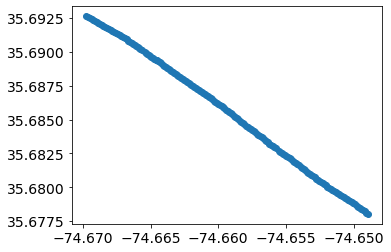

In [150]:
trios_gdf.loc['2021-08-28 15:20:27':'2021-08-28 15:50:47'].plot()

Trim the data to the flight time and closest locations.

In [116]:
chla_gdf.head(1)

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry,time_str
0,0.275804,35.784628,-74.626711,2021-08-28 19:28:11,28.54,"[0.004250132761414206, 0.0014477659671346182, ...",POINT (-74.62671 35.78463),2021-08-28 19:28:11


In [151]:
trios_gdf_transect = trios_gdf.loc['2021-08-28 19:00:00':chla_gdf.iloc[len(chla_gdf)-1]['time']]

In [121]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return(chla_gdf[nearest].Latitude.values[0])

trios_gdf_transect['uas_lat'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return(chla_gdf[nearest].Longitude.values[0])

trios_gdf_transect['uas_lon'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,947,948,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-28 15:00:10,08/28/2021 11:00:10,0.065738,0.065455,0.065203,0.064478,0.063878,0.063358,0.063333,0.062966,0.062317,...,0.067502,0.067350,0.066673,0.066002,2021-08-28 11:00:10,35.678305,-74.671013,POINT (-74.67101 35.67831),35.778803,-74.620378
2021-08-28 15:00:20,08/28/2021 11:00:20,0.011198,0.011077,0.010972,0.010817,0.010668,0.010536,0.010477,0.010355,0.010189,...,0.002746,0.002696,0.002702,0.002754,2021-08-28 11:00:20,35.678143,-74.669902,POINT (-74.66990 35.67814),35.778803,-74.620378


In [122]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return chla_gdf[nearest].lw_spectra.values[0]

trios_gdf_transect['uas_spec'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,948,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-28 15:00:10,08/28/2021 11:00:10,0.065738,0.065455,0.065203,0.064478,0.063878,0.063358,0.063333,0.062966,0.062317,...,0.067350,0.066673,0.066002,2021-08-28 11:00:10,35.678305,-74.671013,POINT (-74.67101 35.67831),35.778803,-74.620378,"[0.004346980038906365, 0.0014649103043104124, ..."
2021-08-28 15:00:20,08/28/2021 11:00:20,0.011198,0.011077,0.010972,0.010817,0.010668,0.010536,0.010477,0.010355,0.010189,...,0.002696,0.002702,0.002754,2021-08-28 11:00:20,35.678143,-74.669902,POINT (-74.66990 35.67814),35.778803,-74.620378,"[0.004346980038906365, 0.0014649103043104124, ..."


In [123]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return chla_gdf[nearest].chla.values[0]

trios_gdf_transect['uas_chla'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec,uas_chla
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-28 15:00:10,08/28/2021 11:00:10,0.065738,0.065455,0.065203,0.064478,0.063878,0.063358,0.063333,0.062966,0.062317,...,0.066673,0.066002,2021-08-28 11:00:10,35.678305,-74.671013,POINT (-74.67101 35.67831),35.778803,-74.620378,"[0.004346980038906365, 0.0014649103043104124, ...",0.274716
2021-08-28 15:00:20,08/28/2021 11:00:20,0.011198,0.011077,0.010972,0.010817,0.010668,0.010536,0.010477,0.010355,0.010189,...,0.002702,0.002754,2021-08-28 11:00:20,35.678143,-74.669902,POINT (-74.66990 35.67814),35.778803,-74.620378,"[0.004346980038906365, 0.0014649103043104124, ...",0.274716


In [124]:
import geopy.distance
def dist_fcn(sample_lat,sample_lon,uas_lat,uas_lon):
    coords_1 = (sample_lat, sample_lon)
    coords_2 = (uas_lat, uas_lon)
    return(geopy.distance.distance(coords_1, coords_2).km)
trios_gdf_transect['pt_dist'] = trios_gdf_transect.apply(lambda row: dist_fcn(row['lat'],row['lon'],row['uas_lat'],row['uas_lon']), axis=1)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


(array([370.,  82.,  35.,  30.,  84., 109.,  33.,  40., 500., 205.]),
 array([ 0.67779   ,  1.81551012,  2.95323023,  4.09095035,  5.22867047,
         6.36639059,  7.50411071,  8.64183083,  9.77955095, 10.91727107,
        12.05499119]),
 <BarContainer object of 10 artists>)

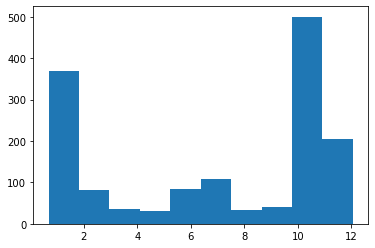

In [125]:
plt.hist(trios_gdf_transect.pt_dist)

In [129]:
matched_subset = trios_gdf_transect[trios_gdf_transect.pt_dist < 0.8]
len(matched_subset)

14

In [130]:
matched_subset

,TimeStamp,320,321,322,323,324,325,326,327,328,...,950,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec,uas_chla,pt_dist
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-28 18:20:40,08/28/2021 14:20:40,0.037664,0.037320,0.037019,0.036428,0.035960,0.035556,0.035456,0.035183,0.034763,...,0.039177,2021-08-28 14:20:40,35.775317,-74.629805,POINT (-74.62981 35.77532),35.781339,-74.625214,"[0.004099949375038306, 0.0013811913717355795, ...",0.277254,0.786637
2021-08-28 18:20:50,08/28/2021 14:20:50,0.020548,0.020294,0.020072,0.019682,0.019368,0.019097,0.019044,0.018903,0.018673,...,0.011608,2021-08-28 14:20:50,35.775428,-74.629733,POINT (-74.62973 35.77543),35.781339,-74.625214,"[0.004099949375038306, 0.0013811913717355795, ...",0.277254,0.772694
2021-08-28 18:21:00,08/28/2021 14:21:00,0.012346,0.012262,0.012187,0.012000,0.011810,0.011643,0.011579,0.011453,0.011275,...,0.002723,2021-08-28 14:21:00,35.775540,-74.629657,POINT (-74.62966 35.77554),35.781339,-74.625214,"[0.004099949375038306, 0.0013811913717355795, ...",0.277254,0.758513
2021-08-28 18:21:10,08/28/2021 14:21:10,0.018995,0.018869,0.018758,0.018508,0.018297,0.018113,0.018095,0.017955,0.017716,...,0.010781,2021-08-28 14:21:10,35.775650,-74.629585,POINT (-74.62959 35.77565),35.781439,-74.625347,"[0.004106471716422561, 0.0013993729211657531, ...",0.277690,0.747909
2021-08-28 18:21:20,08/28/2021 14:21:20,0.024928,0.024808,0.024699,0.024337,0.024043,0.023789,0.023758,0.023600,0.023327,...,0.017303,2021-08-28 14:21:20,35.775762,-74.629512,POINT (-74.62951 35.77576),35.781439,-74.625347,"[0.004106471716422561, 0.0013993729211657531, ...",0.277690,0.733871
2021-08-28 18:21:30,08/28/2021 14:21:30,0.010855,0.010742,0.010645,0.010500,0.010361,0.010237,0.010198,0.010099,0.009951,...,0.002485,2021-08-28 14:21:30,35.775872,-74.629440,POINT (-74.62944 35.77587),35.781439,-74.625347,"[0.004106471716422561, 0.0013993729211657531, ...",0.277690,0.720071
2021-08-28 18:21:40,08/28/2021 14:21:40,0.013482,0.013405,0.013336,0.013140,0.012961,0.012804,0.012777,0.012676,0.012510,...,0.003553,2021-08-28 14:21:40,35.775980,-74.629365,POINT (-74.62937 35.77598),35.781439,-74.625347,"[0.004106471716422561, 0.0013993729211657531, ...",0.277690,0.706275
2021-08-28 18:21:50,08/28/2021 14:21:50,0.015249,0.015100,0.014971,0.014745,0.014524,0.014331,0.014288,0.014175,0.013995,...,0.005425,2021-08-28 14:21:50,35.776068,-74.629282,POINT (-74.62928 35.77607),35.781439,-74.625347,"[0.004106471716422561, 0.0013993729211657531, ...",0.277690,0.693995
2021-08-28 18:22:00,08/28/2021 14:22:00,0.011779,0.011668,0.011570,0.011384,0.011210,0.011059,0.011011,0.010910,0.010761,...,0.003253,2021-08-28 14:22:00,35.776152,-74.629208,POINT (-74.62921 35.77615),35.781339,-74.625214,"[0.004099949375038306, 0.0013811913717355795, ...",0.277254,0.679478


In [131]:
matched_subset.columns[1:-10]

Index(['320', '321', '322', '323', '324', '325', '326', '327', '328', '329',
       ...
       '940', '941', '942', '943', '944', '945', '946', '947', '948', '949'],
      dtype='object', length=630)

In [132]:
plt.rcParams.update({'font.size': 14})

Text(0.5, 0, 'Wavelength (nm)')

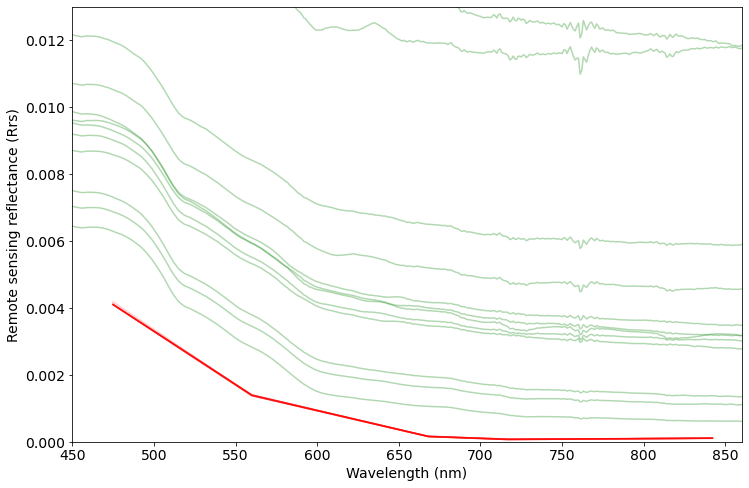

In [135]:
fig,ax = plt.subplots(figsize=(12,8))
for i in range(len(matched_subset)):
    ax.plot(matched_subset.columns[1:-11].astype(int),matched_subset.iloc[i,1:-11], color='green', alpha=0.3)
    ax.plot([475, 560, 668, 717, 842],matched_subset.iloc[i].uas_spec, color='red', alpha=0.2)
ax.set_xlim(450,860)
ax.set_ylim(0,0.013)
ax.set_ylabel('Remote sensing reflectance (Rrs)')
ax.set_xlabel('Wavelength (nm)')
# fig.savefig('comparing_trios_to_altum.png',dpi=300)

In [136]:
matched_subset['chla_oci'] = oc_index(matched_subset.iloc[:, 156:161].mean(axis=1).values, matched_subset.iloc[:, 232:240].mean(axis=1).values, matched_subset.iloc[:, 346:351].mean(axis=1).values)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


(0.0, 0.3)

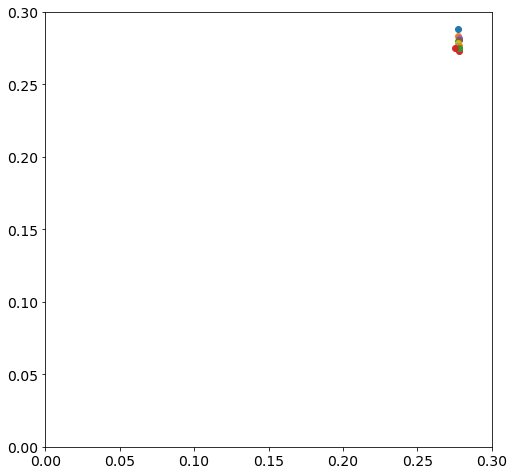

In [139]:
fig, ax = plt.subplots(figsize=(8,8))
for i in range(len(matched_subset)):
    plt.scatter(matched_subset.iloc[i].uas_chla, matched_subset.iloc[i].chla_oci)
plt.xlim(0,.3)
plt.ylim(0,.3)

In [ ]:
cgdf_copy = chla_gdf.copy()
cgdf_copy['time_str'] = cgdf_copy['time'].astype(str)
cgdf_copy['lw_spectra'] = cgdf_copy['lw_spectra'].astype(str)
cgdf_copy.drop('time', 1).to_file('data/oc_analysis_20210828_A2_gulf_stream_surveys.shp')